<a href="https://colab.research.google.com/github/Atsinis/ML-case-studies/blob/main/Sinitsa_AS_ML_Project_v_1_1release_Music_genre_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Music genre prediction

**Описание задачи**

Вы сотрудник Отдела Data Science популярного музыкального стримингового сервиса. Сервис расширяет работу с новыми артистами и музыкантами, в связи с чем возникла задача -- правильно классифицировать новые музыкальные треки, чтобы улучшить работу рекомендательной системы. Ваши коллеги из отдела работы со звуком подготовили датасет, в котором собраны некоторые характеристики музыкальных произведений и их жанры. Ваша задача - разработать модель, позволяющую классифицировать музыкальные произведения по жанрам.

В ходе работы пройдите все основные этапы полноценного исследования:

*  загрузка и ознакомление с данными
*  предварительная обработка
*  полноценный разведочный анализ
*  разработка новых синтетических признаков
*  проверка на мультиколлинеарность
*  отбор финального набора обучающих признаков
*  выбор и обучение моделей
*  итоговая оценка качества предсказания лучшей модели
*  анализ важности ее признаков

**ВАЖНО**  
Необходимо реализовать решение с использованием технологии `pipeline` (из библиотеки `sklearn`)

**ОЖИДАЕМЫЙ РЕЗУЛЬТАТ**

* Оформленный репозиторий на GitHub (ноутбук с исследованием + код приложения)
* Развернутое web-приложение (с использованием библиотеки Streamlit)

## Участники проекта, репозиторий, приложение

***Синица Александр Сергеевич***


## Импорт библиотек, установка констант и гиперпараметров

In [1]:
# INSTALLING LIBRARIES
!pip uninstall -y seaborn pandas
!pip install numpy==1.26.4 -q
!pip install ydata-profiling -q
!pip install catboost -q
!pip install xgboost -q
!pip install optuna -q
!pip install seaborn pandas -q

!pip install optuna-integration[sklearn] -q
!pip install optuna-integration[xgboost] -q
!pip install optuna-integration[catboost] -q

# GENEREAL LIBS
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import traceback
import time
import math
import pandas as pd

# ML / PREPROCESSING
from re import X
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, classification_report, f1_score
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.exceptions import NotFittedError
from sklearn.linear_model import LogisticRegression # Import LogisticRegression
from sklearn.svm import SVC # Import SVC
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

# MODELS
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
import optuna
from optuna.integration import OptunaSearchCV
from optuna.distributions import CategoricalDistribution, IntDistribution, FloatDistribution

Found existing installation: seaborn 0.13.2
Uninstalling seaborn-0.13.2:
  Successfully uninstalled seaborn-0.13.2
Found existing installation: pandas 2.3.3
Uninstalling pandas-2.3.3:
  Successfully uninstalled pandas-2.3.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas==2.2.2, but you have pandas 2.3.3 which is incompatible.
dask-cudf-cu12 25.6.0 requires pandas<2.2.4dev0,>=2.0, but you have pandas 2.3.3 which is incompatible.
cudf-cu12 25.6.0 requires pandas<2.2.4dev0,>=2.0, but you have pandas 2.3.3 which is incompatible.


In [2]:
TRAIN = "https://www.dropbox.com/scl/fi/5zy935lqpaqr9lat76ung/music_genre_train.csv?rlkey=ccovu9ml8pfi9whk1ba26zdda&dl=1"
TEST = "https://www.dropbox.com/scl/fi/o6mvsowpp9r3k2lejuegt/music_genre_test.csv?rlkey=ac14ydue0rzlh880jwj3ebum4&dl=1"

In [3]:
RANDOM_STATE = 42
TEST_SIZE = 0.2

## Загрузка и обзор данных

In [4]:
df_train = pd.read_csv(TRAIN)
df_test = pd.read_csv(TEST)

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

df_train.sample(5)
df_test.sample(5)

Train data shape: (20394, 16)
Test data shape:  (5099, 15)


,instance_id,track_name,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence
4914,24466,Edge Of My Seat,0.114000,0.722,223493.0,0.847,0.009730,G#,0.4360,-5.342,Major,0.0451,108.014,4-Apr,0.715
3793,54765,Mushrooms,0.170000,0.573,225053.0,0.601,0.000000,C#,0.0688,-7.539,Major,0.0367,155.915,4-Apr,0.336
682,56337,Engine No. 9,0.000093,0.358,-1.0,0.981,0.000193,D,0.3860,-5.130,Major,0.1780,93.744,4-Apr,0.382
3811,90553,If Everyone Cared,0.000273,0.522,215106.0,0.874,0.005790,F#,0.2610,-4.392,Minor,0.0362,132.018,4-Apr,0.196
1805,84826,You Don't Care,0.873000,0.636,262351.0,0.614,0.007610,F#,0.1030,-8.597,Major,0.2050,78.019,4-Apr,0.433


**Описание полей данных**

`instance_id` - уникальный идентификатор трека  
`track_name` - название трека  
`acousticness` - акустичность  
`danceability` - танцевальность  
`duration_ms` -продолжительность в милисекундах  
`energy` - энергичность  
`instrumentalness` - инструментальность  
`key` - тональность  
`liveness` - привлекательность  
`loudness` - громкость  
`mode` - наклонение  
`speechiness` - выразительность  
`tempo` - темп  
`obtained_date` - дата загрузки в сервис  
`valence` - привлекательность произведения для пользователей сервиса  
`music_genre` - музыкальный жанр

## Предварительная обработка данных

In [5]:
### PREPROCESSING PART 1 - MISSES AND DUPLICATES

# DUPLICATES SEARCH

train_num_dublicates = df_train.duplicated().sum()
print("Number of duplicates in train = " + str(train_num_dublicates))

test_num_dublicates = df_test.duplicated().sum()
print("Number of dplicates in test  = " + str(test_num_dublicates))

# ! NO DUPLICATES FOUND

# MISSES SEARCH

names_missing_columns  = df_train.columns[df_train.isnull().any()].tolist()
print("Columns with misses in df_train:", names_missing_columns)
train_num_misses = df_train.isnull().sum()
print("Number of misses in df_train = " + str(train_num_misses))

names_missing_columns  = df_test.columns[df_test.isnull().any()].tolist()
print("Columns with misses in df_test:" , names_missing_columns)
test_num_misses = df_test.isnull().sum()
print("Columns with misses in dtest = " + str(test_num_misses))

# ! Misses in keys, mode and tempo

from ydata_profiling import ProfileReport
from IPython.display import display

# Ydata-profiling dashboard for train
profile_train = ProfileReport(df_train, title=" Ydata-profiling dashboard for train")
display(profile_train.to_notebook_iframe())
# Ydata-profiling dashboard for test
profile_test = ProfileReport(df_test, title="Ydata-profiling dashboard for test")
display(profile_test.to_notebook_iframe())

# ! Dataset is generally OK, small number of misses.
# Solution for misses: for missed keys we chose 'G' key (most common), for missed mode we chose 'Major' (probably not very important category), for 'tempo" use median

df_train['key'].fillna('G', inplace=True)
df_train['mode'].fillna('Major', inplace=True)
df_train['tempo'].fillna(df_train['tempo'].median(), inplace=True)


df_test['key'].fillna('G', inplace=True)
df_test['mode'].fillna('Major', inplace=True)
df_test['tempo'].fillna(df_test['tempo'].median(), inplace=True)

# Also: duration must be only positive. If it is not, replace with median value.
df_train['duration_ms'] = df_train['duration_ms'].apply(lambda x: x if x > 0 else df_train['duration_ms'].median())
df_test['duration_ms'] = df_test['duration_ms'].apply(lambda x: x if x > 0 else df_test['duration_ms'].median())

# Drop instance_id as unnecessary because all tracks already have an index.
df_train = df_train.drop('instance_id', axis=1)
df_test = df_test.drop('instance_id', axis=1)

Number of duplicates in train = 0
Number of dplicates in test  = 0
Columns with misses in df_train: ['key', 'mode', 'tempo']
Number of misses in df_train = instance_id           0
track_name            0
acousticness          0
danceability          0
duration_ms           0
energy                0
instrumentalness      0
key                 735
liveness              0
loudness              0
mode                506
speechiness           0
tempo               442
obtained_date         0
valence               0
music_genre           0
dtype: int64
Columns with misses in df_test: ['key', 'mode', 'tempo']
Columns with misses in dtest = instance_id           0
track_name            0
acousticness          0
danceability          0
duration_ms           0
energy                0
instrumentalness      0
key                 158
liveness              0
loudness              0
mode                149
speechiness           0
tempo               121
obtained_date         0
valence               0

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 16/16 [00:02<00:00,  7.01it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

None

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 15/15 [00:00<00:00, 29.62it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

None

/tmp/ipython-input-2393806676.py:40: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_train['key'].fillna('G', inplace=True)
/tmp/ipython-input-2393806676.py:41: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using '

In [6]:
### EDA PART 1 - BASIC STATISTICS

print("\n Statistics for numbers in train:")
print(df_train.describe().T)

print("\n Statistics for numbers in  test:")
print(df_test.describe().T)

cat_cols_train = df_train.select_dtypes(include='object').columns
numeric_cols_train = df_train.select_dtypes(include='number').columns

print("\n Statistics for categoricals in train:")
for col in cat_cols_train:
    print(f"\nTrain - {col}:\n", df_train[col].value_counts())

cat_cols_test = df_test.select_dtypes(include='object').columns
numeric_cols_test = df_test.select_dtypes(include='number').columns

print("\n Statistics for categoricals in test:")
for col in cat_cols_train:
    print(f"\nTest - {col}:\n", df_train[col].value_counts())

comparison = pd.DataFrame(index=numeric_cols_train)
comparison['train_mean'] = df_train[numeric_cols_train].mean()
comparison['train_median'] = df_train[numeric_cols_train].median()
comparison['test_mean'] = df_test[numeric_cols_test].mean()
comparison['test_median'] = df_test[numeric_cols_test].median()

print("\n Comparing stats for train and test:")
print(comparison)

# Main statistics comparison show that train and test datasets are quite balanced for most characteristics.


 Statistics for numbers in train:
                    count           mean            std          min  \
acousticness      20394.0       0.274783       0.321643      0.00000   
danceability      20394.0       0.561983       0.171898      0.06000   
duration_ms       20394.0  242001.580318  103961.566813  15509.00000   
energy            20394.0       0.625276       0.251238      0.00101   
instrumentalness  20394.0       0.159989       0.306503      0.00000   
liveness          20394.0       0.198540       0.166742      0.01360   
loudness          20394.0      -8.552998       5.499917    -44.40600   
speechiness       20394.0       0.091352       0.097735      0.02230   
tempo             20394.0     120.922366      30.096343     34.76500   
valence           20394.0       0.464588       0.243387      0.00000   

                           25%            50%            75%          max  
acousticness           0.01520       0.120000       0.470000        0.996  
danceability        

## Разведочный анализ

In [7]:
# CHECKING SAME CATEGORIAL DESCRIPTION AFTER EXCLUDING TARGET CATEGORY

features_columns = df_train.columns.drop(['music_genre','mode','key'])
duplicated_rows = df_train.duplicated(subset=features_columns, keep=False)
print("\n Objects with same categorical description:", duplicated_rows.sum())

print("\n Namely:")
display(df_train[duplicated_rows])

df_train = df_train.drop_duplicates(subset=features_columns, keep='first')
df_train = df_train.reset_index(drop=True)

# This simple check is unnecessary as there is no such objects in the dataframe.

# CHECKING SAME TRACK NUMBER (column = track_name)

duplicated_tracks = df_train.duplicated(subset='track_name', keep=False)
print("\n Objects with same track name:", duplicated_tracks.sum())

print("\n Namely:")
display(df_train[duplicated_rows])

df_train.sample(5)


 Objects with same categorical description: 1061

 Namely:


,track_name,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
1,Toes Across The Floor,0.243000,0.452,187133.0,0.670,0.000051,A,0.1080,-8.392,Minor,0.0352,113.071,4-Apr,0.5390,Rock
2,First Person on Earth,0.228000,0.454,173448.0,0.804,0.000000,E,0.1810,-5.225,Minor,0.3710,80.980,4-Apr,0.3440,Alternative
41,Just A Friend,0.120000,0.862,238267.0,0.663,0.000000,C,0.3180,-9.004,Major,0.2100,85.308,4-Apr,0.8370,Hip-Hop
49,Star67,0.747000,0.478,294973.0,0.395,0.000005,G,0.2640,-7.917,Major,0.2130,74.515,3-Apr,0.1700,Hip-Hop
62,Energy,0.468000,0.795,195320.0,0.811,0.000000,C#,0.0907,-4.376,Major,0.1570,142.974,4-Apr,0.4510,Rap
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20329,Beyond The Stars,0.000007,0.406,222049.0,0.952,0.025200,G#,0.1980,-2.987,Major,0.0424,88.563,4-Apr,0.5340,Rap
20370,Be My Escape,0.006050,0.554,240453.0,0.864,0.000000,A,0.1320,-5.062,Major,0.0394,112.523,4-Apr,0.2990,Alternative
20371,Trap Queen,0.024400,0.746,222093.0,0.873,0.000000,G,0.3540,-3.803,Major,0.1280,148.075,4-Apr,0.8170,Rap
20375,アシタカとサン - Piano Solo Feature,0.975000,0.338,273400.0,0.126,0.911000,C#,0.1070,-14.419,Major,0.0284,79.882,4-Apr,0.0648,Classical



 Objects with same track name: 2151

 Namely:


/tmp/ipython-input-3724939760.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  display(df_train[duplicated_rows])


,track_name,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
1,Toes Across The Floor,0.243000,0.452,187133.0,0.670,0.000051,A,0.1080,-8.392,Minor,0.0352,113.071,4-Apr,0.539,Rock
2,First Person on Earth,0.228000,0.454,173448.0,0.804,0.000000,E,0.1810,-5.225,Minor,0.3710,80.980,4-Apr,0.344,Alternative
41,Just A Friend,0.120000,0.862,238267.0,0.663,0.000000,C,0.3180,-9.004,Major,0.2100,85.308,4-Apr,0.837,Hip-Hop
49,Star67,0.747000,0.478,294973.0,0.395,0.000005,G,0.2640,-7.917,Major,0.2130,74.515,3-Apr,0.170,Hip-Hop
62,Energy,0.468000,0.795,195320.0,0.811,0.000000,C#,0.0907,-4.376,Major,0.1570,142.974,4-Apr,0.451,Rap
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19749,I'm Waiting For The Man - Album Version (Stereo),0.029700,0.675,279520.0,0.641,0.863000,G,0.1440,-9.754,Major,0.0427,125.891,4-Apr,0.854,Rock
19757,"""ラスボス""への道",0.003530,0.647,144787.0,0.710,0.772000,C#,0.1040,-7.494,Major,0.0442,112.068,4-Apr,0.426,Anime
19813,"Symphony No.3 In E-Flat Major, Op.55 - ""Eroica...",0.862000,0.253,1055173.0,0.104,0.811000,D#,0.0896,-18.163,Major,0.0398,151.623,3-Apr,0.194,Classical
19823,BLUE LIGHTNING,0.000039,0.367,250253.0,0.876,0.000164,C#,0.0797,-3.858,Major,0.0554,189.033,4-Apr,0.626,Anime


,track_name,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
8582,Distant Lonesome Train,0.000884,0.606,353707.0,0.809,0.482000,B,0.3500,-7.031,Minor,0.0570,105.043,4-Apr,0.529,Blues
19793,Summer 99,0.000145,0.810,316191.0,0.968,0.513000,B,0.0542,-3.984,Minor,0.1030,125.984,4-Apr,0.560,Electronic
5002,Jingle Bell Rock,0.122000,0.650,123400.0,0.736,0.000000,C,0.0998,-5.222,Major,0.0378,129.941,4-Apr,0.595,Country
4762,She Just Wants To Dance,0.157000,0.820,208427.0,0.548,0.000134,D,0.0805,-9.577,Major,0.0437,112.133,4-Apr,0.741,Blues
5234,Sweet Talking Hippie,0.030600,0.471,219533.0,0.659,0.007780,E,0.0514,-11.097,Minor,0.0567,145.529,4-Apr,0.818,Blues


                  acousticness  danceability  duration_ms    energy  \
acousticness          1.000000     -0.277203     0.056915 -0.767721   
danceability         -0.277203      1.000000    -0.173904  0.187648   
duration_ms           0.056915     -0.173904     1.000000 -0.076015   
energy               -0.767721      0.187648    -0.076015  1.000000   
instrumentalness      0.317986     -0.254562     0.164681 -0.321273   
liveness             -0.093043     -0.082030     0.042446  0.178288   
loudness             -0.701317      0.321248    -0.121720  0.823107   
speechiness          -0.146256      0.256102    -0.097117  0.153148   
tempo                -0.214206     -0.056798    -0.044844  0.249590   
valence              -0.224268      0.391448    -0.159572  0.349335   

                  instrumentalness  liveness  loudness  speechiness     tempo  \
acousticness              0.317986 -0.093043 -0.701317    -0.146256 -0.214206   
danceability             -0.254562 -0.082030  0.321248  

Text(0.5, 0.98, 'Correlations matrix (Pearson coefficient)')

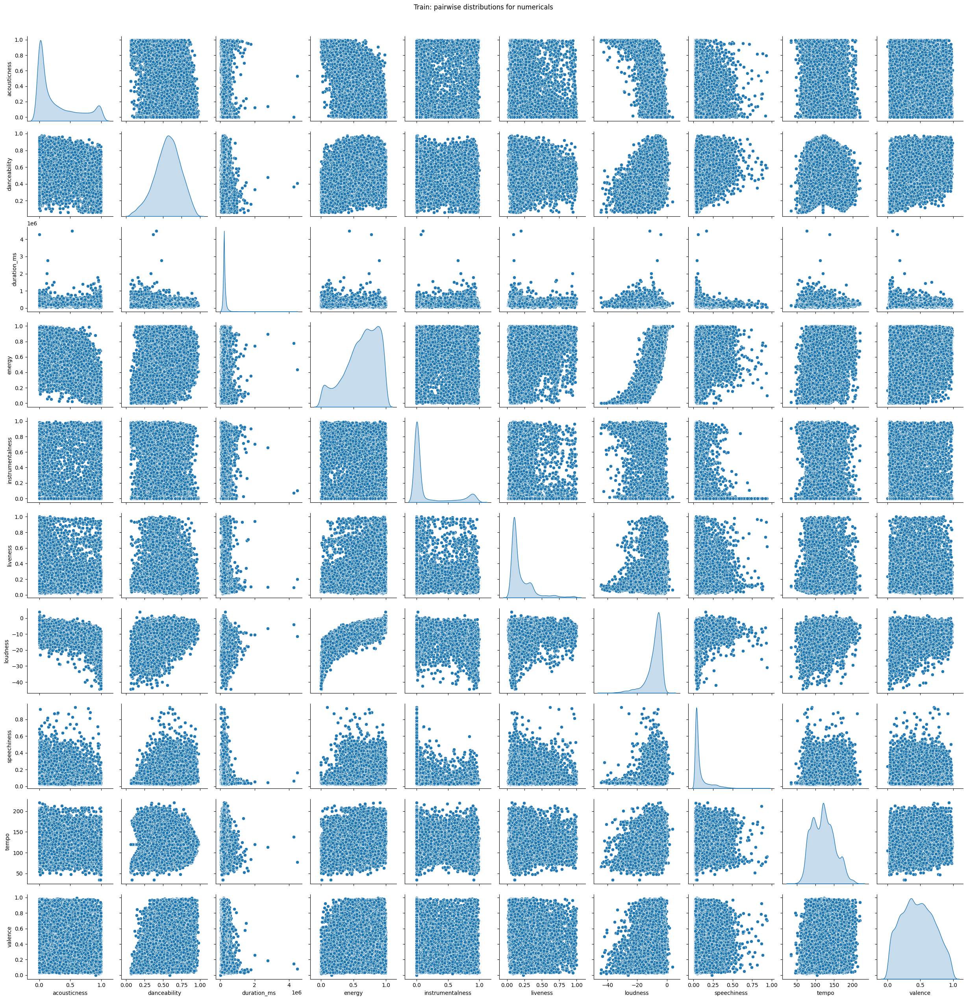

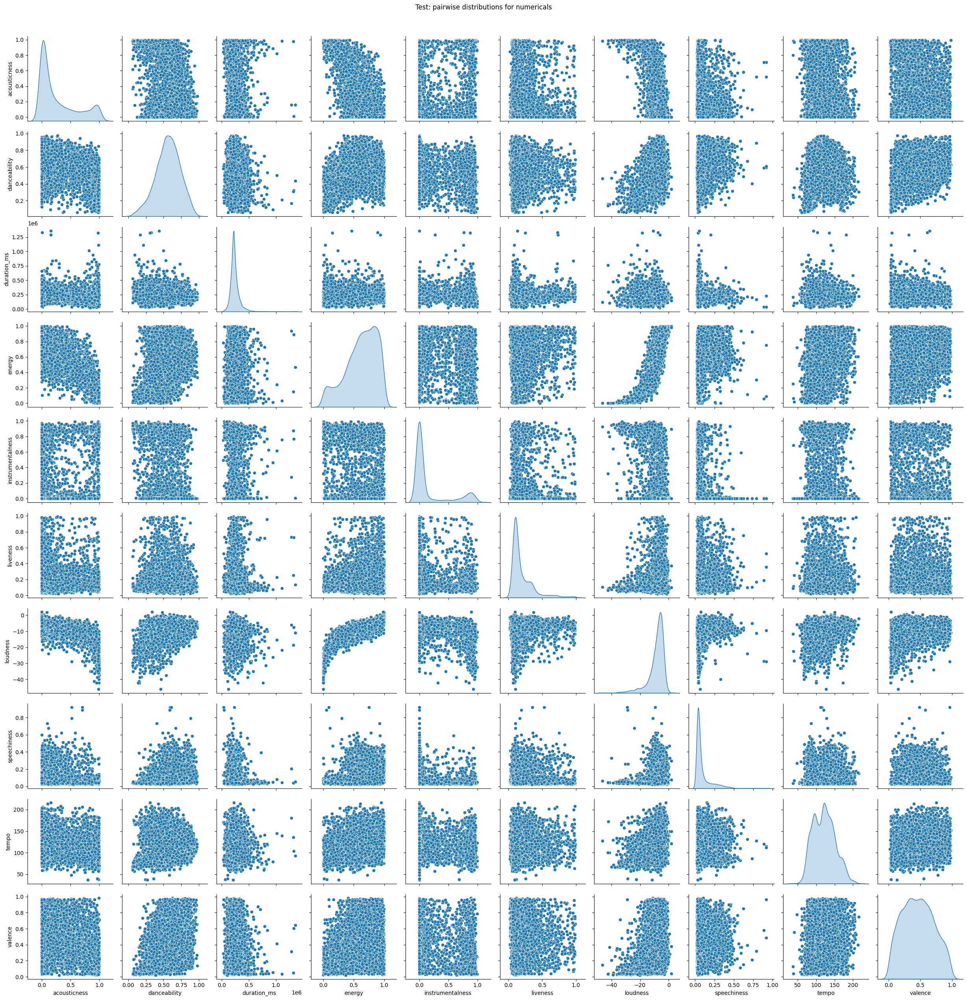

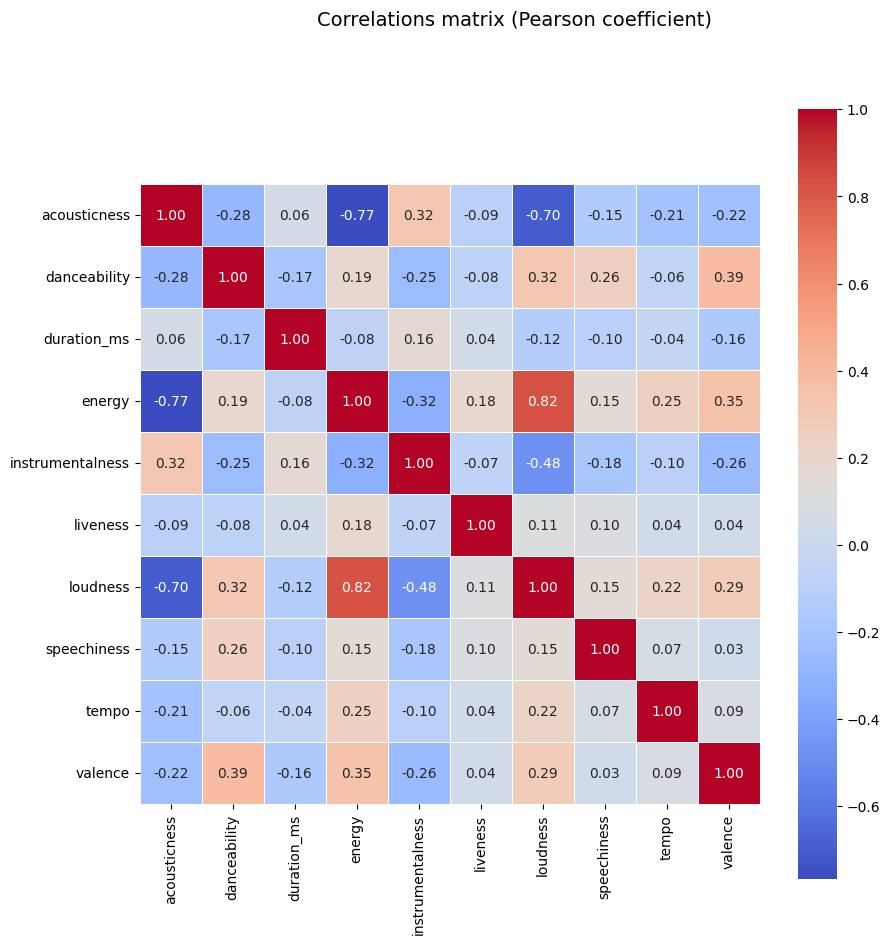

In [8]:
### EDA PART 2 - CORRELATIONS AND CATEGORIES CHECK

# Plotting pairwise distributions for train and test

numeric_cols_train = df_train.select_dtypes(include=['int64', 'float64']).columns.drop('music_genre', errors='ignore')
plt_train = sns.pairplot(df_train[numeric_cols_train], diag_kind="kde")
plt_train.fig.suptitle("Train: pairwise distributions for numericals", y=1.02)

numeric_cols_test = df_test.select_dtypes(include=['int64', 'float64']).columns
plt_test = sns.pairplot(df_test[numeric_cols_test], diag_kind="kde")
plt_test.fig.suptitle("Test: pairwise distributions for numericals", y=1.02)

# Analyzing correlations for numeric categories

numeric_df = df_train.select_dtypes(include=['int64', 'float64'])
corr_matrix = numeric_df.corr()
print(corr_matrix)

# 5 top correlated categories (within numerical features)
abs_corr_matrix = corr_matrix.abs().stack()
sorted_corr = abs_corr_matrix.sort_values(ascending=False)
sorted_corr = sorted_corr[sorted_corr != 1.0]

# Get the top 5 pairs of correlated features
top_5_pairs = sorted_corr.head(10) # Get top 10 as pairs are listed twice (e.g., (A, B) and (B, A))
print("\nTop 5 pairs of numerical features with highest absolute correlation:")
print(top_5_pairs)

min_corr_pair = sorted_corr.tail(1)
print("\n Less correlated pair:", min_corr_pair)

max_corr_pair = sorted_corr.head(1)
print("\n Most correlated pair:", max_corr_pair)

fig_all_corrs, ax_all_corrs = plt.subplots(figsize=(10, 10))
plt_all_corrs = sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True, linewidths=0.5, ax=ax_all_corrs)
fig_all_corrs.suptitle('Correlations matrix (Pearson coefficient)', fontsize=14)



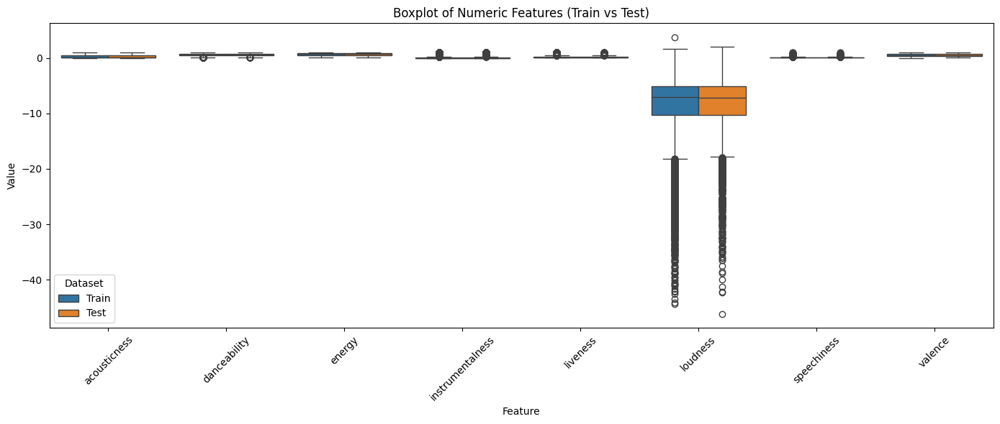

In [9]:
# !! LET US MAKE BOXPLOTS FOR TRAIN AND TREST! посмотрим выбросы и статистические данные наглядно


train_num = df_train.drop(columns= ['music_genre', 'duration_ms', 'tempo']).select_dtypes(include='number')
test_num = df_test.select_dtypes(include='number').drop(columns = ['duration_ms', 'tempo'])


train_melted = train_num.melt(var_name='Feature', value_name='Value')
test_melted = test_num.melt(var_name='Feature', value_name='Value')

train_melted['Dataset'] = 'Train'
test_melted['Dataset'] = 'Test'
combined = pd.concat([train_melted, test_melted], axis=0)

plt.figure(figsize=(14, 6))
sns.boxplot(x='Feature', y='Value', hue='Dataset', data=combined)
plt.xticks(rotation=45)
plt.title('Boxplot of Numeric Features (Train vs Test)')
plt.tight_layout()
plt.show()

Median 'acousticness' for each music genre in the training data:


,instrumentalness
music_genre,
Alternative,0.000068
Anime,0.000255
Blues,0.000987
Classical,0.837000
Country,0.000001
Electronic,0.177000
Hip-Hop,0.000000
Jazz,0.134000
Rap,0.000000


Average 'acousticness' for each music genre in the training data:


,instrumentalness
music_genre,
Alternative,0.061732
Anime,0.269108
Blues,0.092081
Classical,0.597288
Country,0.005183
Electronic,0.348273
Hip-Hop,0.010650
Jazz,0.364152
Rap,0.008267


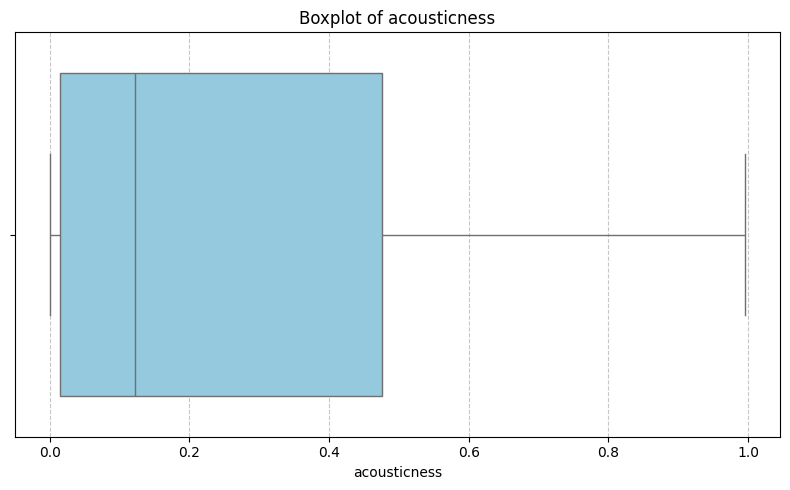

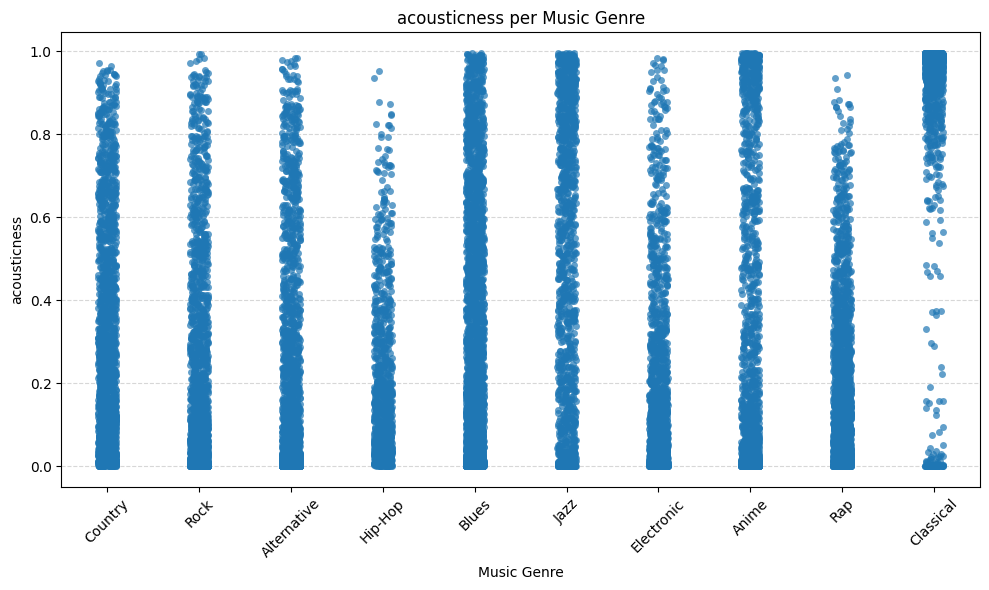

In [10]:
# Calculate and print the median acousticness for each music genre in the training data
median_acousticness_by_genre = df_train.groupby('music_genre')['instrumentalness'].median()
print("Median 'acousticness' for each music genre in the training data:")
display(median_acousticness_by_genre)

# Calculate and print the average acousticness for each music genre in the training data
average_acousticness_by_genre = df_train.groupby('music_genre')['instrumentalness'].mean()
print("Average 'acousticness' for each music genre in the training data:")
display(average_acousticness_by_genre)

# BOXPLOT FOR acousticness

plt.figure(figsize=(8, 5))
sns.boxplot(data=df_train, x='acousticness', color='skyblue')
plt.title('Boxplot of acousticness')
plt.xlabel('acousticness')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# SCATTER PLOT BY MUSIC GENRE
plt.figure(figsize=(10, 6))
sns.stripplot(data=df_train, x='music_genre', y='acousticness', jitter=True, alpha=0.7)
plt.title('acousticness per Music Genre')
plt.ylabel('acousticness')
plt.xlabel('Music Genre')
plt.xticks(rotation=45)
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


--- Analyzing 'acousticness' ---

Statistics for 'acousticness' in train:
count    19859.000000
mean         0.277147
std          0.323054
min          0.000000
25%          0.015400
50%          0.122000
75%          0.476000
max          0.996000
Name: acousticness, dtype: float64

Statistics for 'acousticness' in test:
count    5099.000000
mean        0.276324
std         0.322657
min         0.000002
25%         0.016600
50%         0.120000
75%         0.460000
max         0.996000
Name: acousticness, dtype: float64


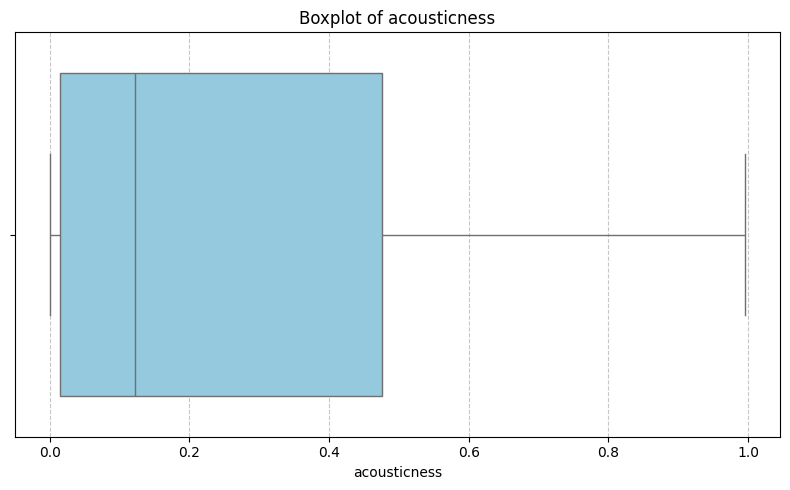

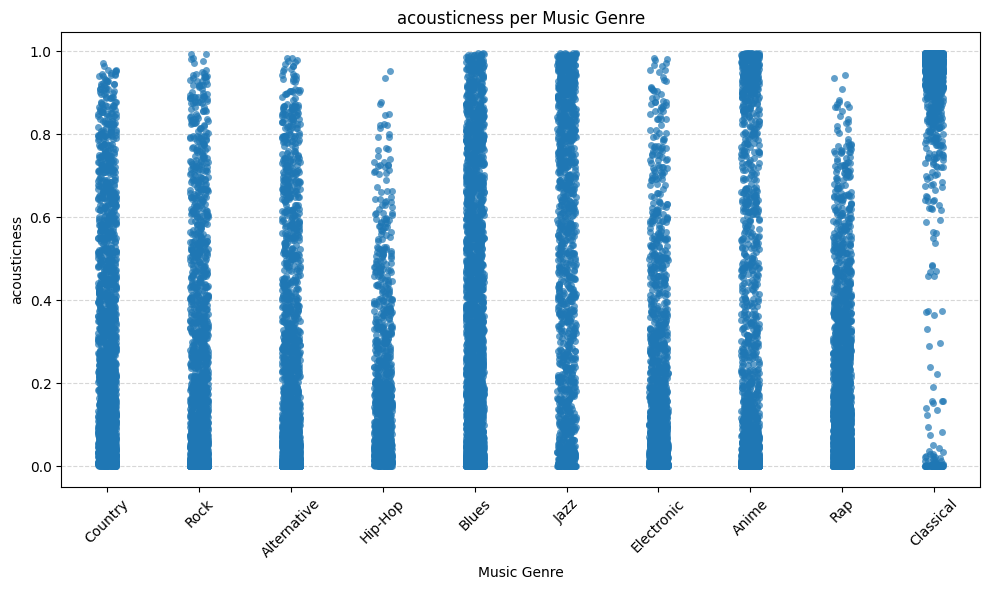


--- Analyzing 'danceability' ---

Statistics for 'danceability' in train:
count    19859.000000
mean         0.560911
std          0.172124
min          0.060000
25%          0.450000
50%          0.569000
75%          0.682000
max          0.978000
Name: danceability, dtype: float64

Statistics for 'danceability' in test:
count    5099.000000
mean        0.561888
std         0.170502
min         0.059600
25%         0.451000
50%         0.568000
75%         0.681000
max         0.977000
Name: danceability, dtype: float64


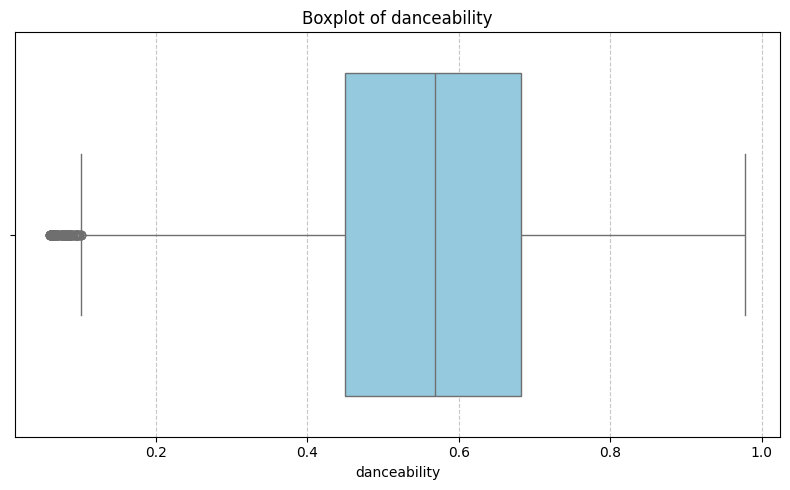

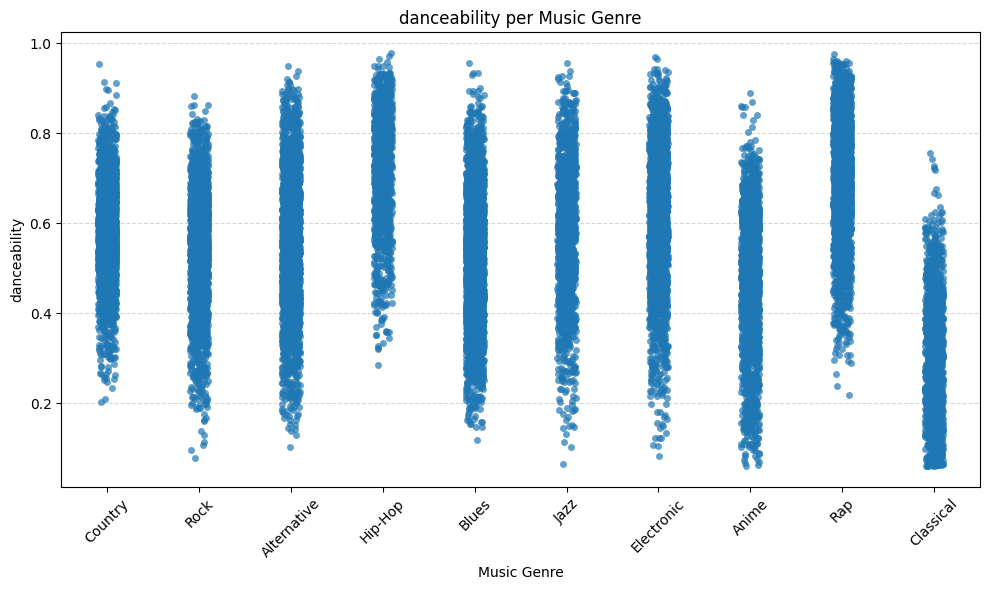


--- Analyzing 'duration_ms' ---

Statistics for 'duration_ms' in train:
count    1.985900e+04
mean     2.422381e+05
std      1.048574e+05
min      1.550900e+04
25%      1.960270e+05
50%      2.195330e+05
75%      2.662810e+05
max      4.497994e+06
Name: duration_ms, dtype: float64

Statistics for 'duration_ms' in test:
count    5.099000e+03
mean     2.391091e+05
std      9.045292e+04
min      2.275000e+04
25%      1.944285e+05
50%      2.175000e+05
75%      2.642470e+05
max      1.360027e+06
Name: duration_ms, dtype: float64


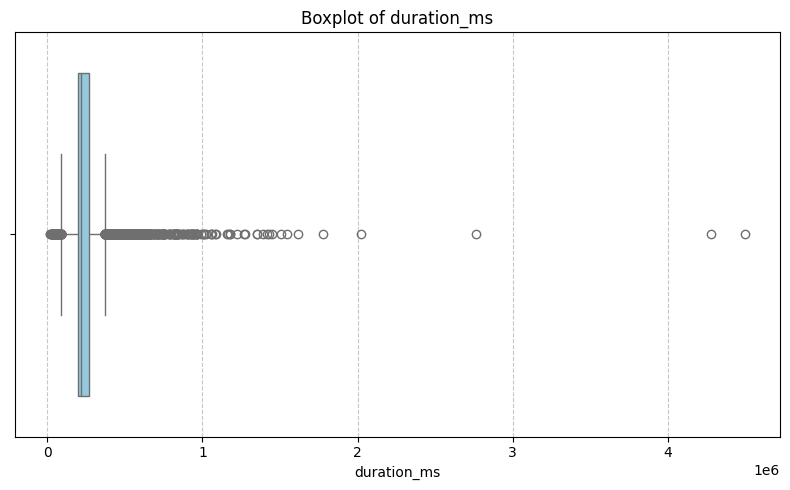

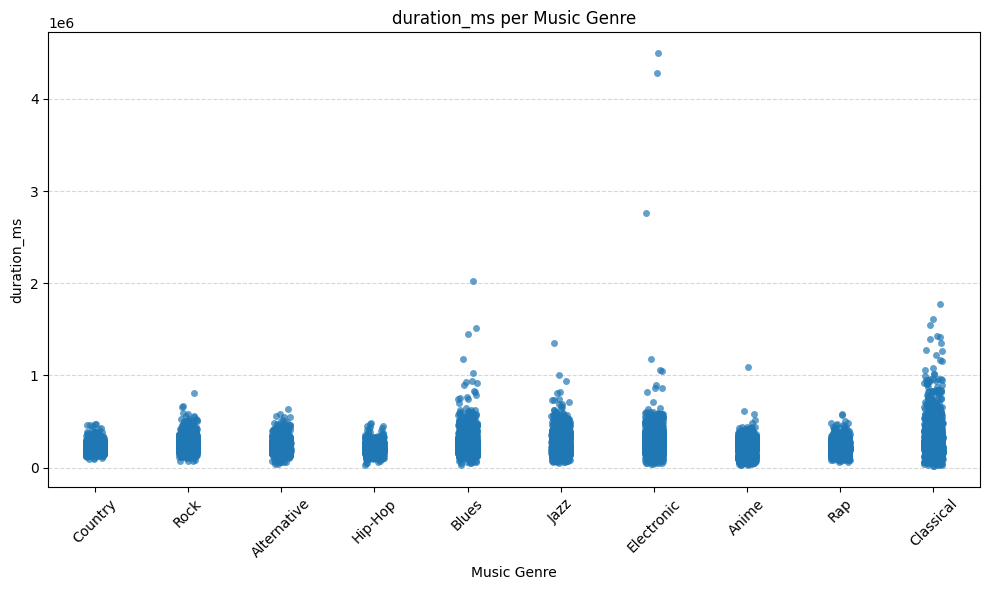


--- Analyzing 'energy' ---

Statistics for 'energy' in train:
count    19859.000000
mean         0.623738
std          0.252367
min          0.001010
25%          0.467500
50%          0.665000
75%          0.830000
max          0.999000
Name: energy, dtype: float64

Statistics for 'energy' in test:
count    5099.000000
mean        0.622030
std         0.251829
min         0.001540
25%         0.465000
50%         0.660000
75%         0.826000
max         0.999000
Name: energy, dtype: float64


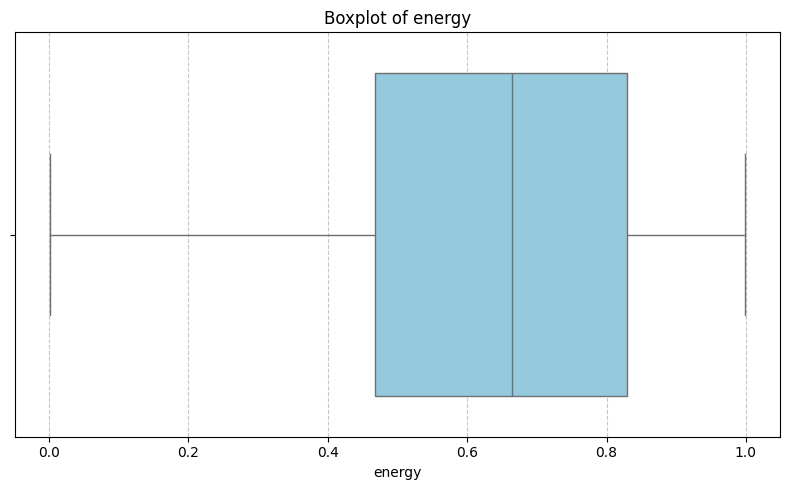

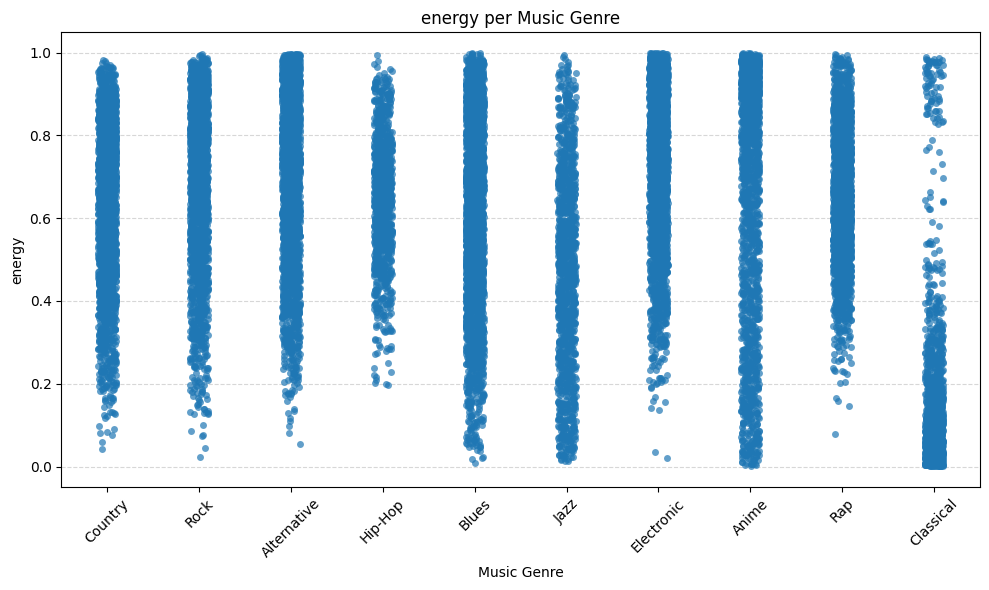


--- Analyzing 'instrumentalness' ---

Statistics for 'instrumentalness' in train:
count    19859.000000
mean         0.162565
std          0.308495
min          0.000000
25%          0.000000
50%          0.000159
75%          0.092950
max          0.996000
Name: instrumentalness, dtype: float64

Statistics for 'instrumentalness' in test:
count    5099.000000
mean        0.165198
std         0.311940
min         0.000000
25%         0.000000
50%         0.000157
75%         0.092750
max         0.994000
Name: instrumentalness, dtype: float64


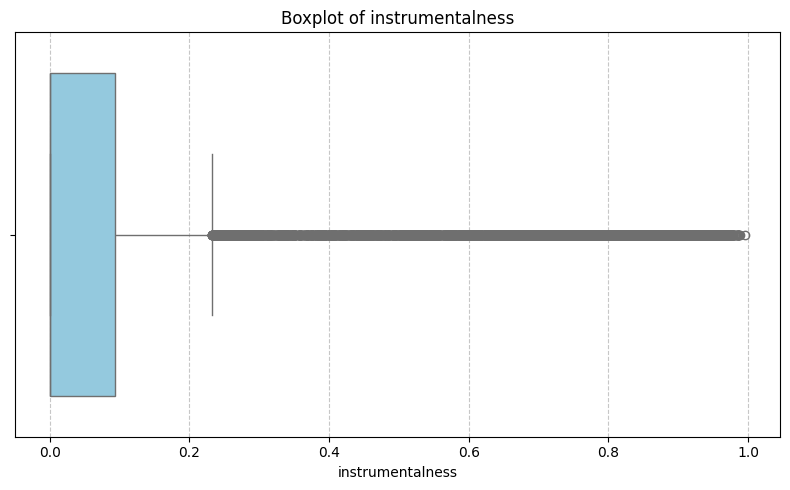

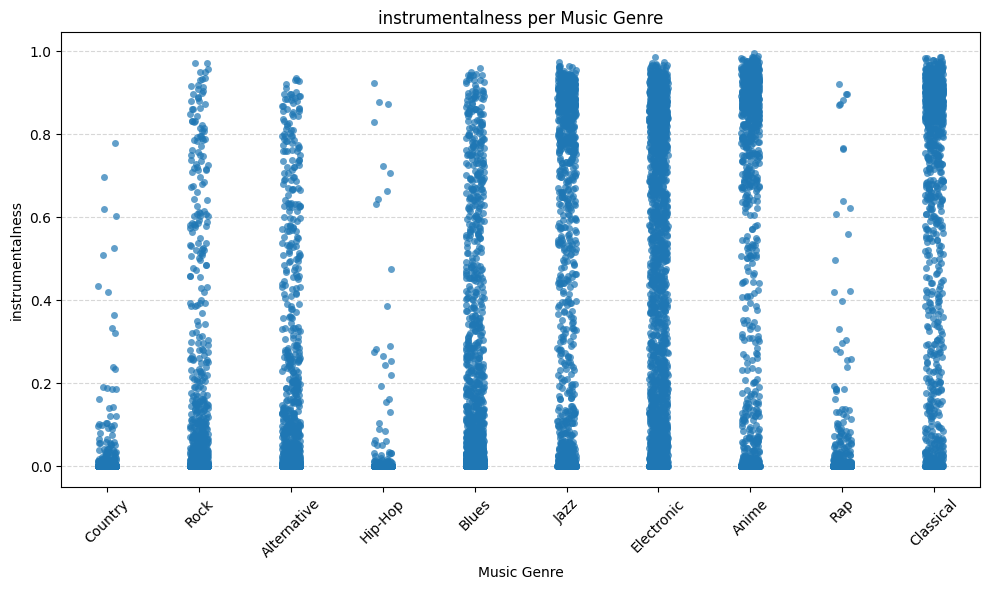


--- Analyzing 'liveness' ---

Statistics for 'liveness' in train:
count    19859.000000
mean         0.198514
std          0.167150
min          0.013600
25%          0.097300
50%          0.129000
75%          0.252000
max          1.000000
Name: liveness, dtype: float64

Statistics for 'liveness' in test:
count    5099.000000
mean        0.197924
std         0.166241
min         0.020400
25%         0.096950
50%         0.129000
75%         0.248000
max         0.990000
Name: liveness, dtype: float64


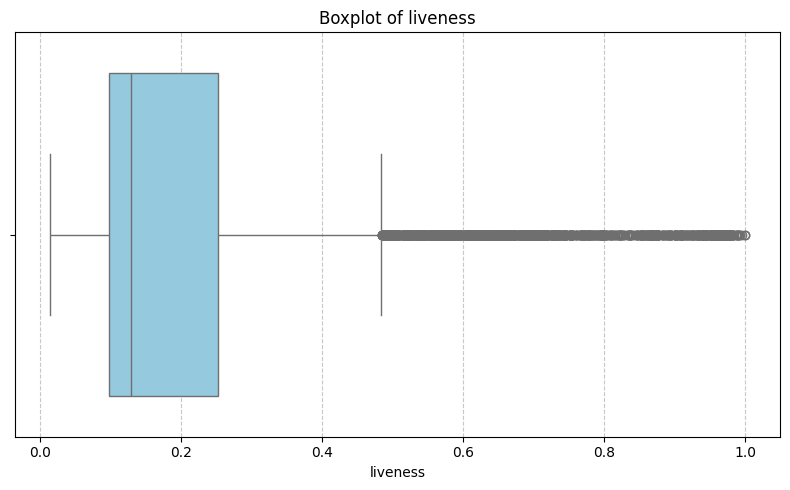

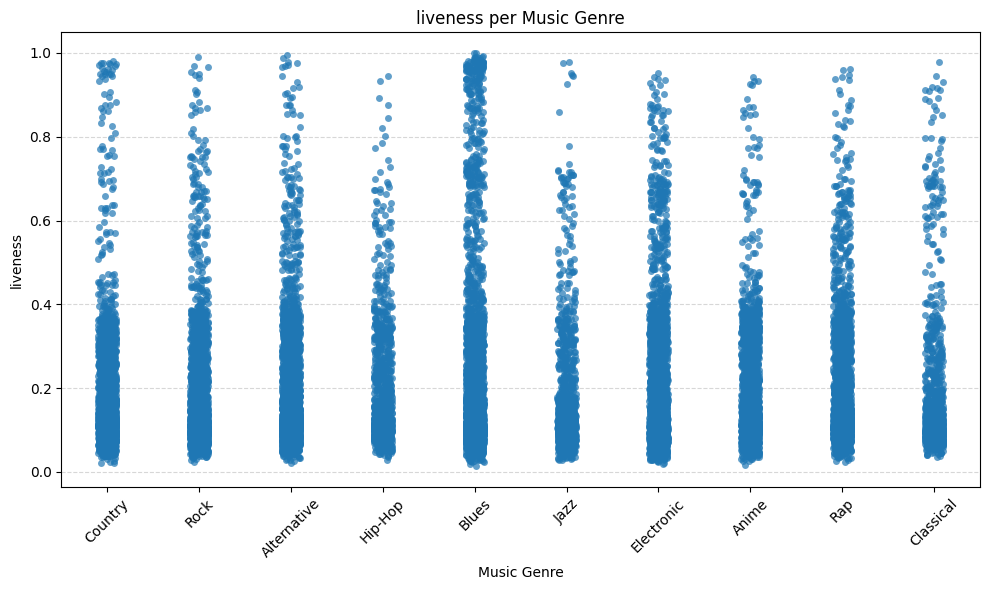


--- Analyzing 'loudness' ---

Statistics for 'loudness' in train:
count    19859.000000
mean        -8.597803
std          5.543211
min        -44.406000
25%        -10.321000
50%         -7.076000
75%         -5.060500
max          3.744000
Name: loudness, dtype: float64

Statistics for 'loudness' in test:
count    5099.000000
mean       -8.630186
std         5.619766
min       -46.122000
25%       -10.231000
50%        -7.135000
75%        -5.127000
max         1.949000
Name: loudness, dtype: float64


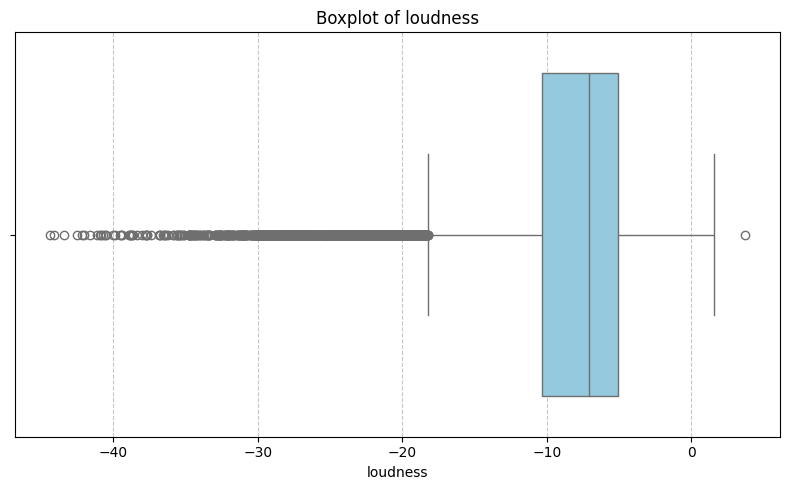

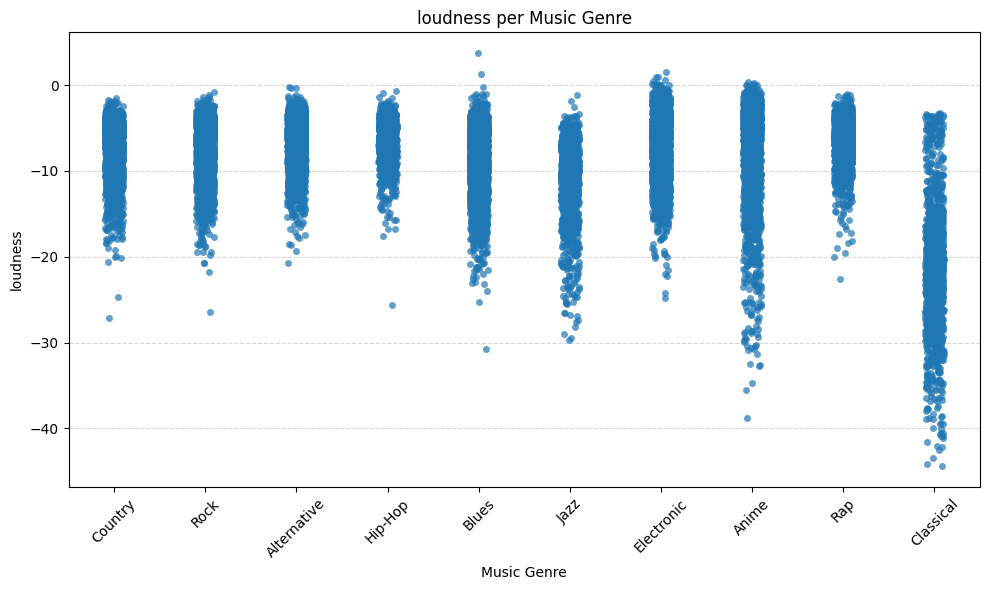


--- Analyzing 'speechiness' ---

Statistics for 'speechiness' in train:
count    19859.000000
mean         0.090687
std          0.097287
min          0.022300
25%          0.035600
50%          0.048800
75%          0.093900
max          0.942000
Name: speechiness, dtype: float64

Statistics for 'speechiness' in test:
count    5099.000000
mean        0.092718
std         0.100130
min         0.022600
25%         0.035700
50%         0.048700
75%         0.096550
max         0.918000
Name: speechiness, dtype: float64


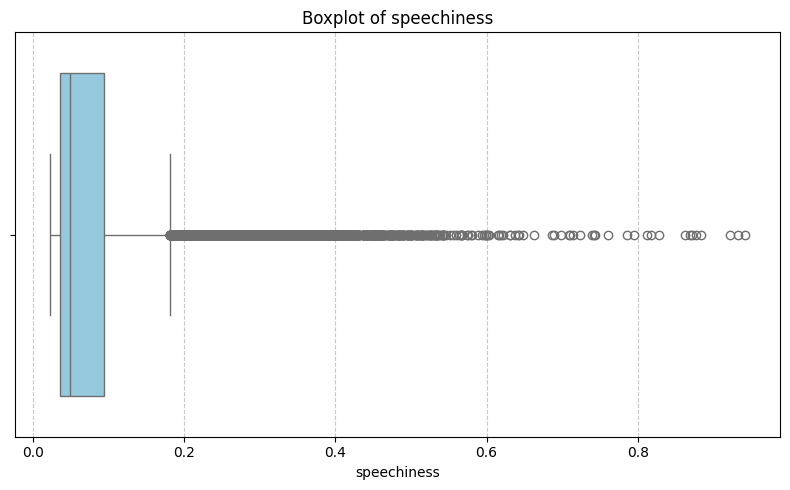

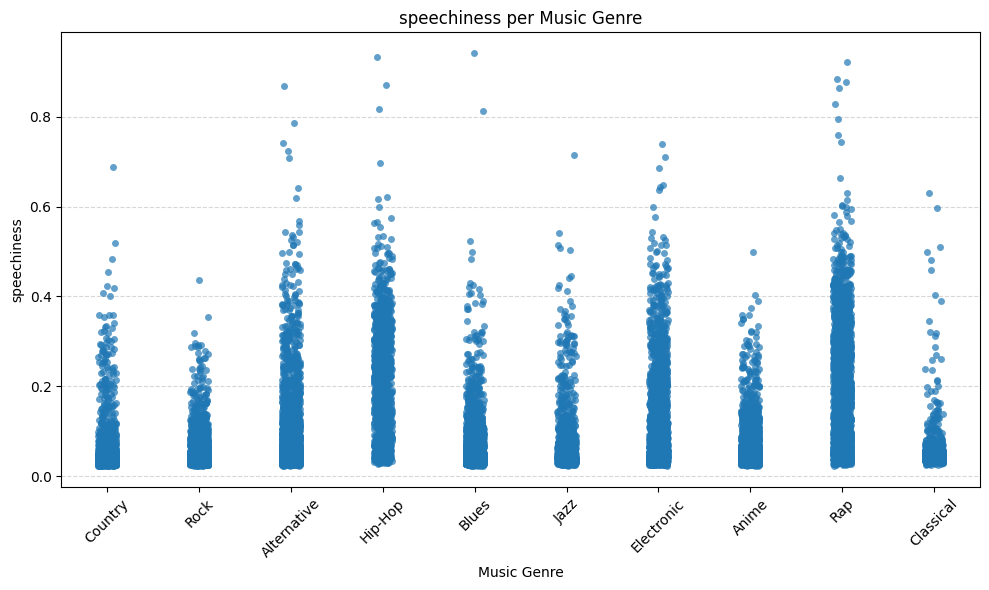


--- Analyzing 'tempo' ---

Statistics for 'tempo' in train:
count    19859.000000
mean       120.948443
std         30.103928
min         34.765000
25%         96.045000
50%        120.012500
75%        140.969500
max        220.041000
Name: tempo, dtype: float64

Statistics for 'tempo' in test:
count    5099.000000
mean      121.218154
std        29.519830
min        37.114000
25%        96.732500
50%       120.053500
75%       141.002500
max       216.029000
Name: tempo, dtype: float64


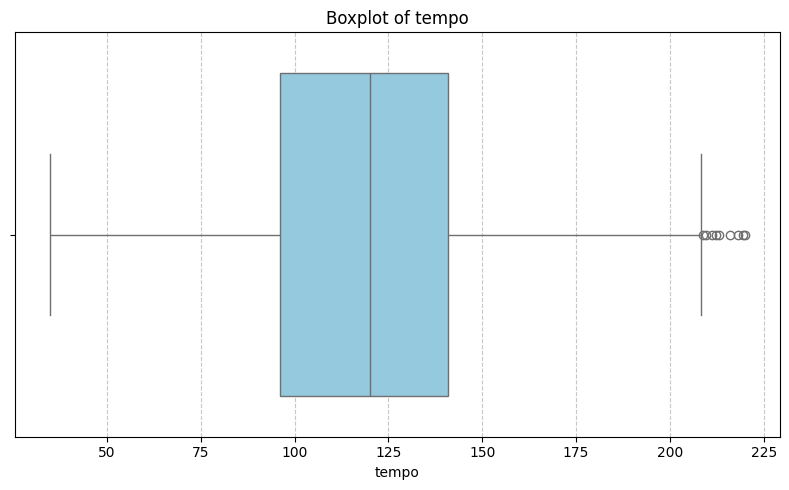

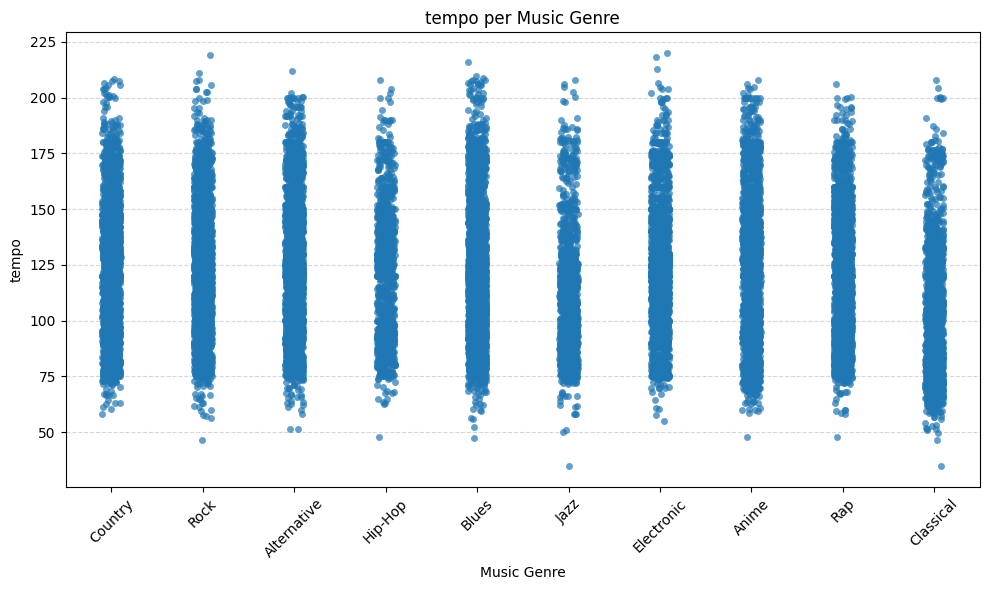


--- Analyzing 'valence' ---

Statistics for 'valence' in train:
count    19859.000000
mean         0.463727
std          0.243863
min          0.000000
25%          0.271000
50%          0.456000
75%          0.653000
max          0.992000
Name: valence, dtype: float64

Statistics for 'valence' in test:
count    5099.000000
mean        0.465593
std         0.244217
min         0.020500
25%         0.272000
50%         0.458000
75%         0.650000
max         0.982000
Name: valence, dtype: float64


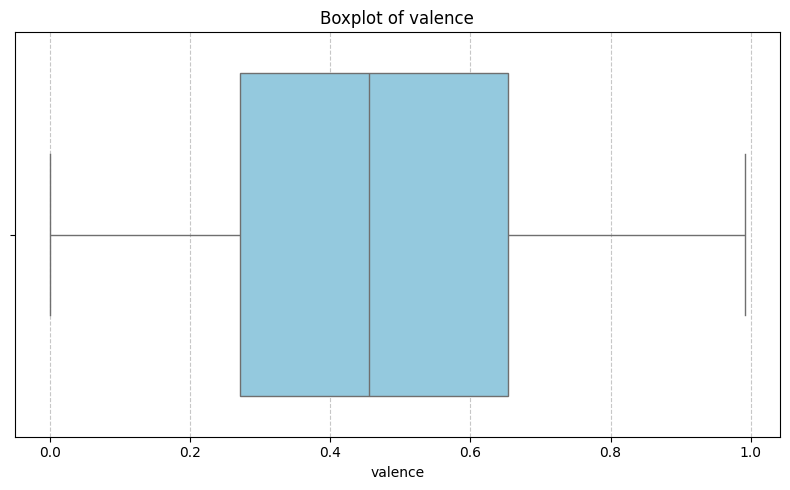

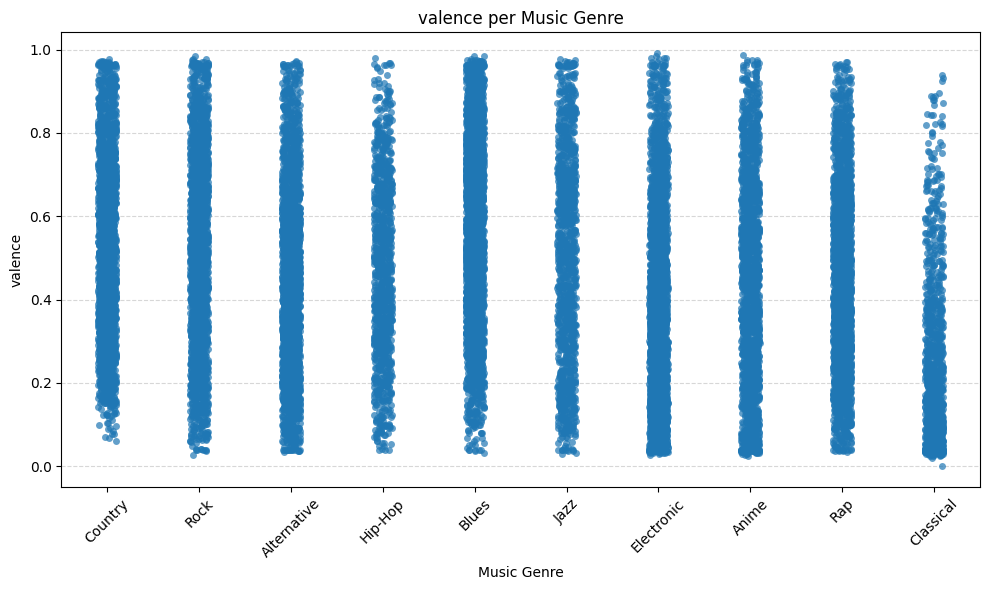

In [11]:
# Generate boxplots and scatter plots for all other numerical features

numerical_cols = df_train.select_dtypes(include=['int64', 'float64']).columns.tolist()
# Exclude columns that have already been plotted or are not relevant for this type of plot
cols_to_plot = [col for col in numerical_cols if col not in ['music_genre', 'track_num_letters', 'track_num_words', 'key']]

for col in cols_to_plot:
    print(f"\n--- Analyzing '{col}' ---")

    # Detailed statistics
    print(f"\nStatistics for '{col}' in train:")
    print(df_train[col].describe())

    print(f"\nStatistics for '{col}' in test:")
    print(df_test[col].describe())

    # BOXPLOT
    plt.figure(figsize=(8, 5))
    sns.boxplot(data=df_train, x=col, color='skyblue')
    plt.title(f'Boxplot of {col}')
    plt.xlabel(col)
    plt.grid(True, axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

    # SCATTER PLOT BY MUSIC GENRE
    plt.figure(figsize=(10, 6))
    sns.stripplot(data=df_train, x='music_genre', y=col, jitter=True, alpha=0.7)
    plt.title(f'{col} per Music Genre')
    plt.ylabel(col)
    plt.xlabel('Music Genre')
    plt.xticks(rotation=45)
    plt.grid(True, axis='y', linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

Median 'instrumentalness' for each music genre in the training data:


,instrumentalness
music_genre,
Alternative,0.000068
Anime,0.000255
Blues,0.000987
Classical,0.837000
Country,0.000001
Electronic,0.177000
Hip-Hop,0.000000
Jazz,0.134000
Rap,0.000000


Average 'instrumentalness' for each music genre in the training data:


,instrumentalness
music_genre,
Alternative,0.061732
Anime,0.269108
Blues,0.092081
Classical,0.597288
Country,0.005183
Electronic,0.348273
Hip-Hop,0.010650
Jazz,0.364152
Rap,0.008267


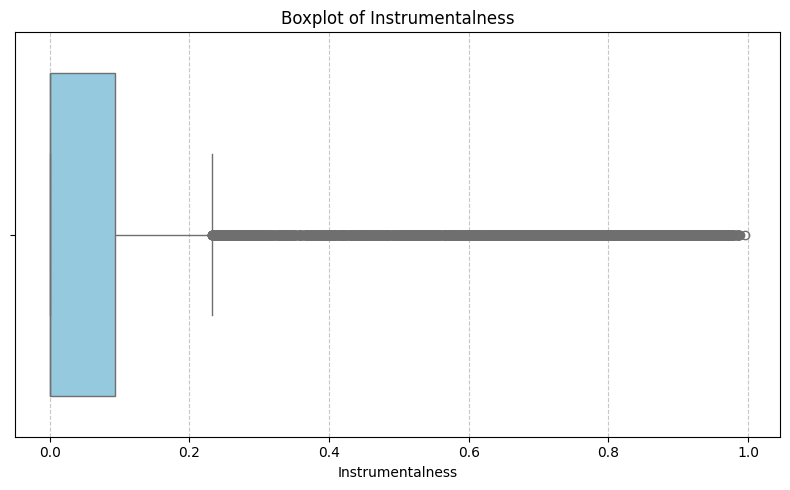

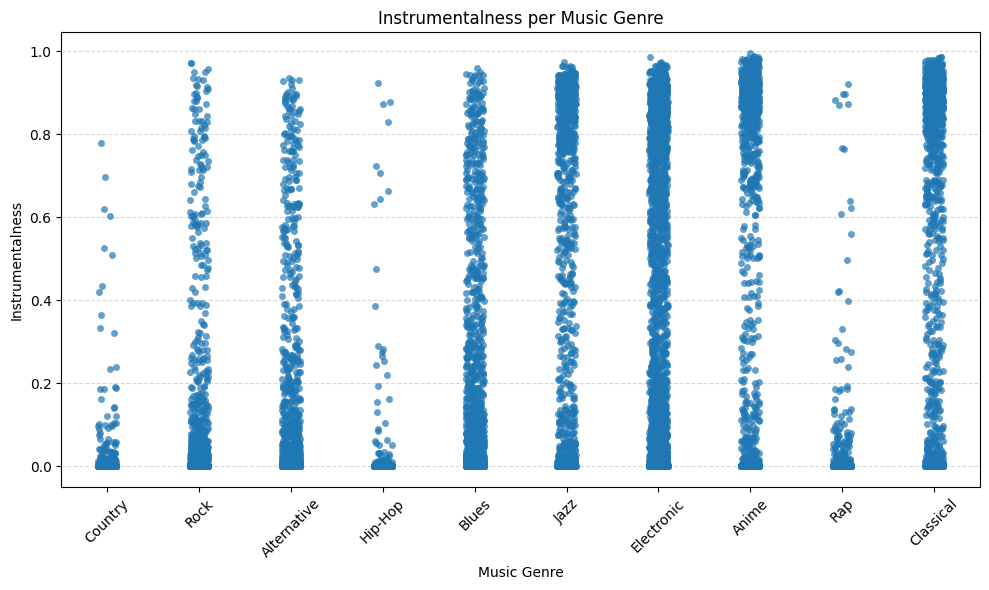

In [12]:
# INSTRUMENTALNESS LOOKS LIKE A BAD FEATURE AS IT HAS A LOT OF ZEROS
# WITHIN EACH MUSIC GENRE, LET'S REPLACE ALL ZEROS WITH MEDIAN VALUE !

# Calculate and print the median instrumentalness for each music genre in the training data
median_instrumentalness_by_genre = df_train.groupby('music_genre')['instrumentalness'].median()
print("Median 'instrumentalness' for each music genre in the training data:")
display(median_instrumentalness_by_genre)

# Calculate and print the average instrumentalness for each music genre in the training data
average_instrumentalness_by_genre = df_train.groupby('music_genre')['instrumentalness'].mean()
print("Average 'instrumentalness' for each music genre in the training data:")
display(average_instrumentalness_by_genre)

# BOXPLOT FOR INSTRUMENTALNESS

plt.figure(figsize=(8, 5))
sns.boxplot(data=df_train, x='instrumentalness', color='skyblue')
plt.title('Boxplot of Instrumentalness')
plt.xlabel('Instrumentalness')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# SCATTER PLOT BY MUSIC GENRE
plt.figure(figsize=(10, 6))
sns.stripplot(data=df_train, x='music_genre', y='instrumentalness', jitter=True, alpha=0.7)
plt.title('Instrumentalness per Music Genre')
plt.ylabel('Instrumentalness')
plt.xlabel('Music Genre')
plt.xticks(rotation=45)
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


 Statistics for 'loudness' in train:
count    19859.000000
mean        -8.597803
std          5.543211
min        -44.406000
25%        -10.321000
50%         -7.076000
75%         -5.060500
max          3.744000
Name: loudness, dtype: float64

 Statistics for 'loudness' in test:
count    5099.000000
mean       -8.630186
std         5.619766
min       -46.122000
25%       -10.231000
50%        -7.135000
75%        -5.127000
max         1.949000
Name: loudness, dtype: float64


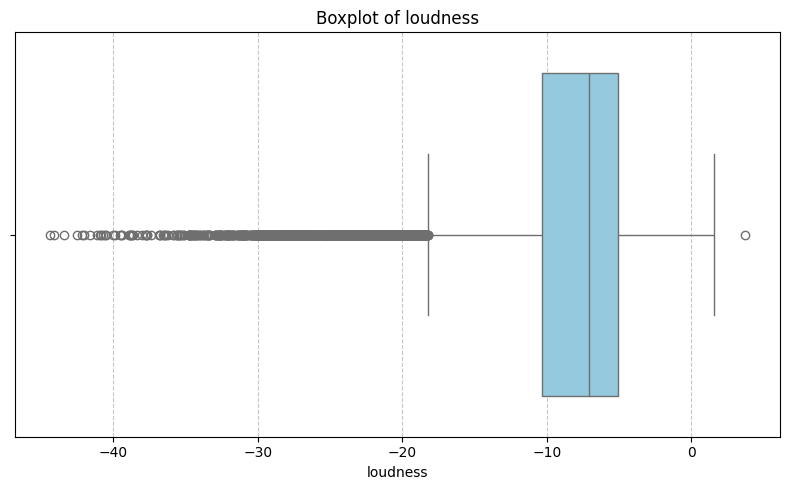

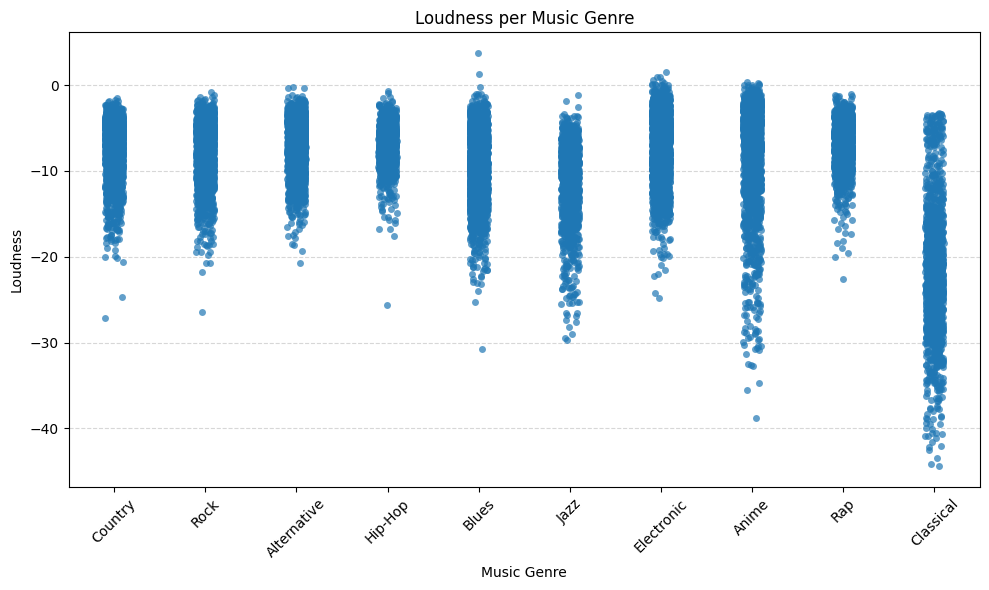

In [13]:
# DETAILED STATISTICS AND BOXPLOT FOR 'LOUDNESS'

print("\n Statistics for 'loudness' in train:")
print(df_train['loudness'].describe())

print("\n Statistics for 'loudness' in test:")
print(df_test['loudness'].describe())

# BOXPLOT FOR LOUDNESS

plt.figure(figsize=(8, 5))
sns.boxplot(data=df_train, x='loudness', color='skyblue')
plt.title('Boxplot of loudness')
plt.xlabel('loudness')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# SCATTER PLOT BY MUSIC GENRE
plt.figure(figsize=(10, 6))
sns.stripplot(data=df_train, x='music_genre', y='loudness', jitter=True, alpha=0.7)
plt.title('Loudness per Music Genre')
plt.ylabel('Loudness')
plt.xlabel('Music Genre')
plt.xticks(rotation=45)
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


## Работа с признаками

In [14]:
# LET US SAVE THE COPY OF CLEANED DATASET BEFORE CATEGORY PROCESSING

df_train_clean = df_train.copy()
df_test_clean = df_test.copy()

# SETTING MUSIC GENRE AS TARGET
y_train = df_train_clean['music_genre']

# MAKING DATAFRAME FOR THE MODEL

X_train = df_train_clean
X_test = df_test_clean


# DROPPING TRACK NAME FOR BASELINE MODEL

df_train_clean_base = df_train_clean.drop('track_name', axis=1)
df_test_clean_base = df_test_clean.drop('track_name', axis=1)


In [15]:
# LET US CHECK THE CATEGORIES FOR MULTICOLLINEARITY

cat_cols = X_train.select_dtypes(include='object').columns
numeric_cols = X_train.select_dtypes(include='number').columns

from statsmodels.stats.outliers_influence import variance_inflation_factor
numeric_cols = X_train.select_dtypes(include=['int64', 'float64']).columns

# CALCULATE VARIANCE INFLATION FACTOR for each numerical feature
vif_data = pd.DataFrame()
vif_data["feature"] = numeric_cols

vif_data["VIF"] = [variance_inflation_factor(X_train[numeric_cols].values, i)  for i in range(len(numeric_cols))]

print("\nVariance Inflation Factor (VIF):")
display(vif_data.sort_values(by="VIF", ascending=False))

## VERY HIGH VIF FOR ENERGY, DANCEABILITY AND TEMPO!!



Variance Inflation Factor (VIF):


,feature,VIF
3,energy,16.618873
8,tempo,15.288401
1,danceability,11.702145
6,loudness,8.354591
9,valence,6.465365
2,duration_ms,6.293220
0,acousticness,3.844438
5,liveness,2.565143
7,speechiness,2.119377
4,instrumentalness,1.788266


In [16]:
# LET US EXCLUDE THE DATE AS IT LOOKS IRRELEVANT FOR MUSIC GENRE

X_train = X_train.drop('obtained_date', axis=1)
X_test = X_test.drop('obtained_date', axis=1)

# ADDING NEW FEATURE - number of symbols track_num_letters and number of words track_num words
X_train['track_num_letters'] = X_train['track_name'].apply(lambda x: len(str(x)))
X_test['track_num_letters'] = X_test['track_name'].apply(lambda x: len(str(x)))

# ADDING NEW FEATURE -  number of words in track number track_num words
X_train['track_num_words'] = X_train['track_name'].apply(lambda x: len(str(x).split()))
X_test['track_num_words'] = X_test['track_name'].apply(lambda x: len(str(x).split()))

# REPLACE FEATURE -  energy and liveness to vibration as average geometrical of both
def geometrical_mean(a, b):
    return math.sqrt(a * b) if a >= 0 and b >= 0 else 0

# ONCE AGAIN CHECK NEGATIVE VALUES IN DURATION AND REPLACE WITH ABSOLUTE VALUE OF MEDIAN
X_train['duration_ms'] = X_train['duration_ms'].apply(lambda x: x if x > 0 else df_train['duration_ms'].median())
X_test['duration_ms'] = X_test['duration_ms'].apply(lambda x: x if x > 0 else df_test['duration_ms'].median())


X_train['vibration'] = X_train.apply(lambda row: geometrical_mean(row['energy'], row['danceability']), axis=1)
X_test['vibration'] = X_test.apply(lambda row: geometrical_mean(row['energy'], row['danceability']), axis=1)

X_train.drop(['energy', 'danceability'], axis=1, inplace=True)
X_test.drop(['energy', 'danceability'], axis=1, inplace=True)

# PREFER A Function to encode musical keys from 1 to 12
def encode_key(key):
    key_mapping = {
        'C': 1,
        'C#': 2,
        'D': 3,
        'D#': 4,
        'E': 5,
        'F': 6,
        'F#': 7,
        'G': 8,
        'G#': 9,
        'A': 10,
        'A#': 11,
        'B': 12
    }
    return key_mapping.get(key, 0)

# Apply the encoding function to the 'key' column
X_train['key'] = X_train['key'].apply(encode_key)
X_test['key'] = X_test['key'].apply(encode_key)

X_train.head()
X_test.head()

,track_name,acousticness,duration_ms,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,track_num_letters,track_num_words,vibration
0,Low Class Conspiracy,0.301000,146213.0,0.00000,11,0.3030,-7.136,Minor,0.3560,90.361,0.895,20,3,0.716940
1,The Hunter,0.538000,240360.0,0.00832,9,0.0849,-5.175,Major,0.0294,78.385,0.318,10,2,0.365907
2,Hate Me Now,0.005830,284000.0,0.00000,10,0.1090,-4.399,Minor,0.2220,90.000,0.412,11,3,0.722537
3,Somebody Ain't You,0.020300,177354.0,0.00000,12,0.1220,-4.604,Major,0.0483,160.046,0.614,18,3,0.665889
4,Sour Mango,0.000335,217500.0,0.01480,3,0.0374,-8.833,Major,0.2020,73.830,0.121,10,2,0.433805


In [17]:
# INSTRUMENTALNESS LOOKS LIKE A BAD FEATURE AS IT HAS A LOT OF ZEROS
# WITHIN EACH MUSIC GENRE, LET'S REPLACE ALL ZEROS WITH MEDIAN VALUE !

# Calculate and print the median instrumentalness for each music genre in the training data
median_instrumentalness_by_genre = X_train.groupby('music_genre')['instrumentalness'].median()
print("Median 'instrumentalness' for each music genre in the training data:")
display(median_instrumentalness_by_genre)

zero_count = (X_train['instrumentalness'] == 0).sum()
print(f"Number of zeros in 'instrumentalness (TRAIN)': {zero_count}")
X_train['instrumentalness'] = X_train.groupby('music_genre')['instrumentalness'].transform(lambda x: x.mask(x == 0, x.median()))
# median_train = X_train.loc[X_train['instrumentalness'] != 0, 'instrumentalness'].median()
# X_train['instrumentalness'] = X_train['instrumentalness'].mask(X_train['instrumentalness'] == 0, median_train)
zero_count_after = (X_train['instrumentalness'] == 0).sum()
print(f"Zeros remaining in TRAIN after replacement: {zero_count_after}")

zero_count_test = (X_test['instrumentalness'] == 0).sum()
print(f"Number of zeros in 'instrumentalness (TEST)': {zero_count_test}")
median_test = X_test.loc[X_test['instrumentalness'] != 0, 'instrumentalness'].median()
X_test['instrumentalness'] = X_test['instrumentalness'].mask(X_test['instrumentalness'] == 0, median_test)
zero_count_test_after = (X_test['instrumentalness'] == 0).sum()
print(f"Zeros remaining in TEST after replacement: {zero_count_test_after}")

# Calculate and print the median instrumentalness for each music genre in the training data
median_instrumentalness_by_genre = df_train.groupby('music_genre')['instrumentalness'].median()
print("Median 'instrumentalness' for each music genre in the training data:")
display(median_instrumentalness_by_genre)

Median 'instrumentalness' for each music genre in the training data:


,instrumentalness
music_genre,
Alternative,0.000068
Anime,0.000255
Blues,0.000987
Classical,0.837000
Country,0.000001
Electronic,0.177000
Hip-Hop,0.000000
Jazz,0.134000
Rap,0.000000


Number of zeros in 'instrumentalness (TRAIN)': 5773
Zeros remaining in TRAIN after replacement: 2156
Number of zeros in 'instrumentalness (TEST)': 1510
Zeros remaining in TEST after replacement: 0
Median 'instrumentalness' for each music genre in the training data:


,instrumentalness
music_genre,
Alternative,0.000068
Anime,0.000255
Blues,0.000987
Classical,0.837000
Country,0.000001
Electronic,0.177000
Hip-Hop,0.000000
Jazz,0.134000
Rap,0.000000



 Statistics for 'instrumentalness' in train:
count    19859.000000
mean         0.166613
std          0.309634
min          0.000000
25%          0.000009
50%          0.000405
75%          0.134000
max          0.996000
Name: instrumentalness, dtype: float64

 Statistics for 'instrumentalness' in test:
count    5099.000000
mean        0.166954
std         0.311020
min         0.000001
25%         0.000499
50%         0.005930
75%         0.092750
max         0.994000
Name: instrumentalness, dtype: float64


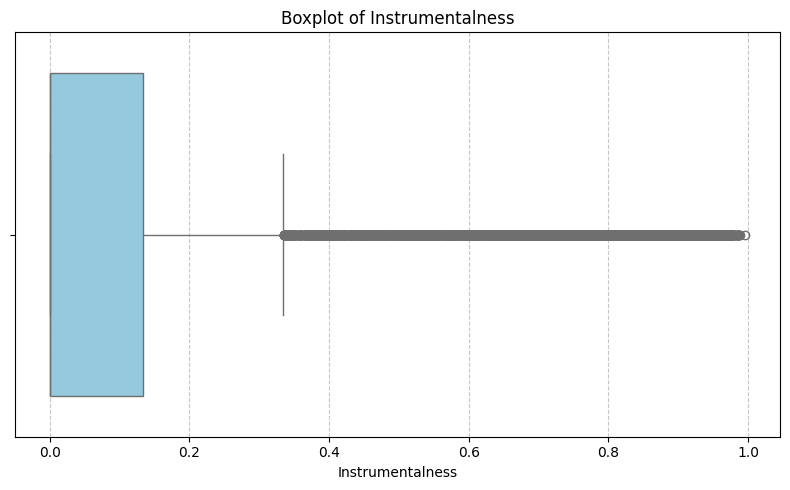

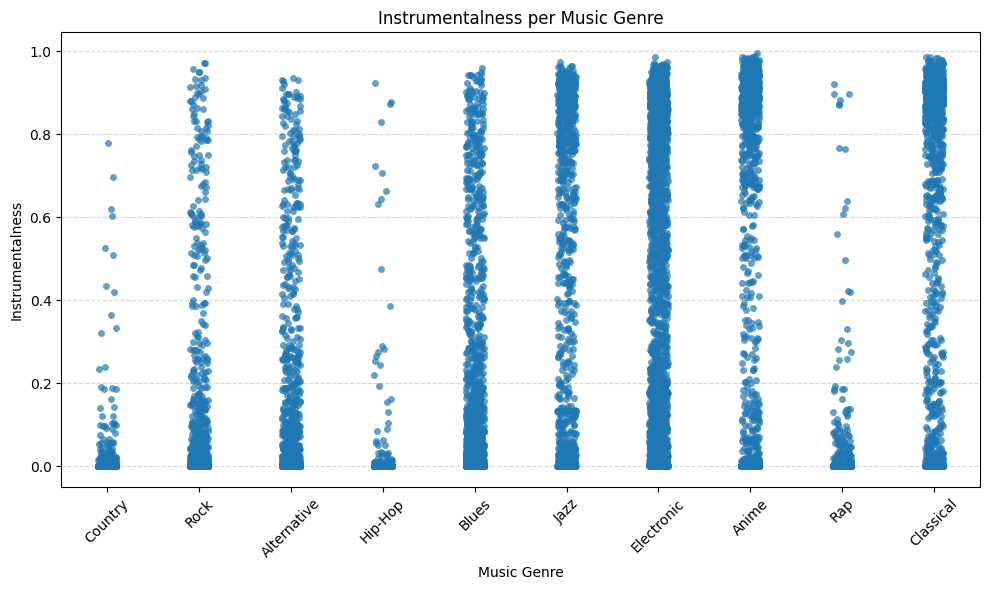

In [18]:
# DETAILED STATISTICS AND BOXPLOT FOR 'INSTRUMENTALNESS'

print("\n Statistics for 'instrumentalness' in train:")
print(X_train['instrumentalness'].describe())

print("\n Statistics for 'instrumentalness' in test:")
print(X_test['instrumentalness'].describe())

# BOXPLOT FOR INSTRUMENTALNESS

plt.figure(figsize=(8, 5))
sns.boxplot(data=X_train, x='instrumentalness', color='skyblue')
plt.title('Boxplot of Instrumentalness')
plt.xlabel('Instrumentalness')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# SCATTER PLOT BY MUSIC GENRE
plt.figure(figsize=(10, 6))
sns.stripplot(data=X_train, x='music_genre', y='instrumentalness', jitter=True, alpha=0.7)
plt.title('Instrumentalness per Music Genre')
plt.ylabel('Instrumentalness')
plt.xlabel('Music Genre')
plt.xticks(rotation=45)
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()



## Выбор и обучение моделей

In [19]:
categorical_cols = ['mode']
numerical_cols = X_train.select_dtypes(include=['int64', 'float64']).columns.tolist()
numerical_cols = [col for col in numerical_cols if col not in categorical_cols]

# Create ENCODING PREPROCESSOR: a ColumnTransformer to apply OneHotEncoder to categorical features
encoding_preprocessor = ColumnTransformer(transformers=[('onehot', OneHotEncoder(handle_unknown='ignore'), categorical_cols)],  remainder='passthrough')

X_train_encoded = encoding_preprocessor.fit_transform(X_train.drop(columns=['track_name', 'music_genre'])) # Drop music_genre
X_test_encoded = encoding_preprocessor.transform(X_test.drop(columns=['track_name']))

# Create CATEGORICAL PREPROCESSOR
preprocessor = ColumnTransformer(
    transformers=[
        ('onehot', OneHotEncoder(handle_unknown='ignore'), categorical_cols),
        ('num', StandardScaler(), numerical_cols)
    ]
)


feature_names = encoding_preprocessor.get_feature_names_out()
X_train_encoded = pd.DataFrame(X_train_encoded, columns=feature_names)
X_test_encoded = pd.DataFrame(X_test_encoded, columns=feature_names)
X_test_encoded = X_test_encoded.reindex(columns=X_train_encoded.columns, fill_value=0)

print("Shape of X_train after encoding:", X_train_encoded.shape)
print("Shape of X_test after encoding:", X_test_encoded.shape)

X_train_encoded.head()
X_test_encoded.head()


Shape of X_train after encoding: (19859, 14)
Shape of X_test after encoding: (5099, 14)


,onehot__mode_Major,onehot__mode_Minor,remainder__acousticness,remainder__duration_ms,remainder__instrumentalness,remainder__key,remainder__liveness,remainder__loudness,remainder__speechiness,remainder__tempo,remainder__valence,remainder__track_num_letters,remainder__track_num_words,remainder__vibration
0,0.0,1.0,0.301000,146213.0,0.00593,11.0,0.3030,-7.136,0.3560,90.361,0.895,20.0,3.0,0.716940
1,1.0,0.0,0.538000,240360.0,0.00832,9.0,0.0849,-5.175,0.0294,78.385,0.318,10.0,2.0,0.365907
2,0.0,1.0,0.005830,284000.0,0.00593,10.0,0.1090,-4.399,0.2220,90.000,0.412,11.0,3.0,0.722537
3,1.0,0.0,0.020300,177354.0,0.00593,12.0,0.1220,-4.604,0.0483,160.046,0.614,18.0,3.0,0.665889
4,1.0,0.0,0.000335,217500.0,0.01480,3.0,0.0374,-8.833,0.2020,73.830,0.121,10.0,2.0,0.433805


## Поиск решения с помощью GridSearch для исходного датасета

🔁 Обучение моделей (Clean Features):   0%|          | 0/4 [00:00<?, ?it/s]


🔍 Tuning LogisticRegression_clean (Clean Features)...
Fitting 3 folds for each of 4 candidates, totalling 12 fits

✅ Best parameters for LogisticRegression_clean: {'classifier__C': 1, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}
✅ Accuracy on validation set for LogisticRegression_clean: 0.4116
🕒 Training time for LogisticRegression_clean: 8.33 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.25      0.28      0.26       498
           1       0.32      0.17      0.22       379
           2       0.41      0.51      0.46       564
           3       0.73      0.80      0.76       274
           4       0.36      0.56      0.43       418
           5       0.54      0.53      0.53       510
           6       0.00      0.00      0.00       213
           7       0.35      0.21      0.27       245
           8       0.45      0.69      0.54       462
           9       0.26      0.11      0.15       409

    accur

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/tmp/ipython-input-1951027541.py:60: FutureWarnin

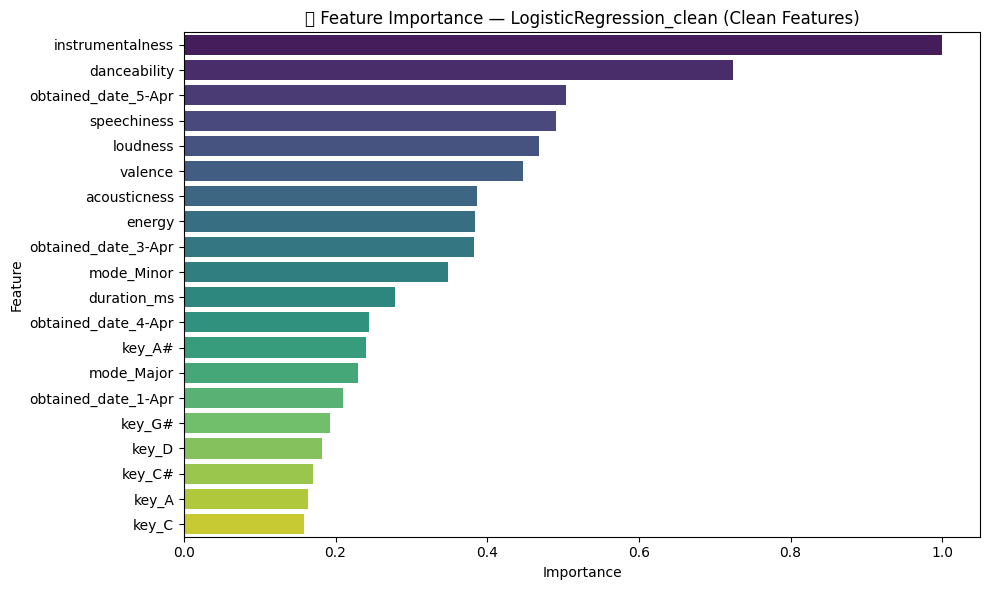

🔁 Обучение моделей (Clean Features):  25%|██▌       | 1/4 [00:08<00:26,  8.89s/it]


🔍 Tuning SVM_clean (Clean Features)...
Fitting 3 folds for each of 6 candidates, totalling 18 fits


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
🔁 Обучение моделей (Clean Features):  50%|█████  


✅ Best parameters for SVM_clean: {'classifier__C': 1, 'classifier__kernel': 'rbf'}
✅ Accuracy on validation set for SVM_clean: 0.4683
🕒 Training time for SVM_clean: 1114.00 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.31      0.38      0.34       498
           1       0.54      0.46      0.50       379
           2       0.46      0.60      0.52       564
           3       0.74      0.80      0.77       274
           4       0.40      0.55      0.46       418
           5       0.61      0.59      0.60       510
           6       0.00      0.00      0.00       213
           7       0.39      0.20      0.27       245
           8       0.46      0.72      0.56       462
           9       0.32      0.07      0.12       409

    accuracy                           0.47      3972
   macro avg       0.42      0.44      0.41      3972
weighted avg       0.44      0.47      0.44      3972

💾 Grid search results saved to: SV

/tmp/ipython-input-1951027541.py:60: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1951027541.py:62: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


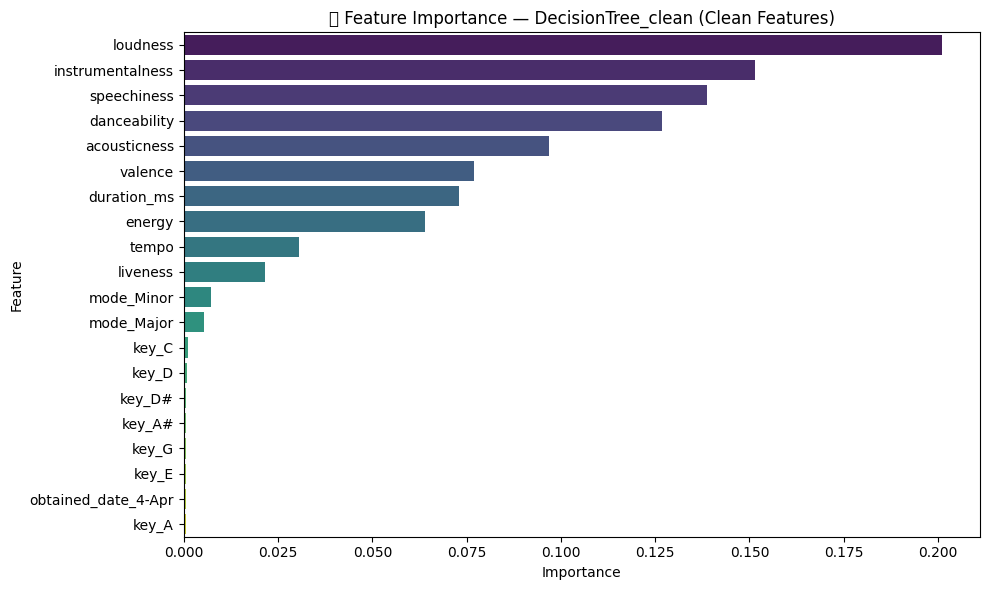

🔁 Обучение моделей (Clean Features):  75%|███████▌  | 3/4 [18:46<05:59, 359.79s/it]


🔍 Tuning RandomForest_clean (Clean Features)...
Fitting 3 folds for each of 4 candidates, totalling 12 fits

✅ Best parameters for RandomForest_clean: {'classifier__max_depth': 20, 'classifier__n_estimators': 100}
✅ Accuracy on validation set for RandomForest_clean: 0.4751
🕒 Training time for RandomForest_clean: 33.89 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.34      0.32      0.33       498
           1       0.56      0.47      0.51       379
           2       0.44      0.61      0.51       564
           3       0.74      0.80      0.77       274
           4       0.44      0.54      0.48       418
           5       0.56      0.66      0.61       510
           6       0.21      0.03      0.05       213
           7       0.42      0.22      0.29       245
           8       0.48      0.71      0.57       462
           9       0.24      0.08      0.12       409

    accuracy                           0.48      3

/tmp/ipython-input-1951027541.py:60: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1951027541.py:62: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


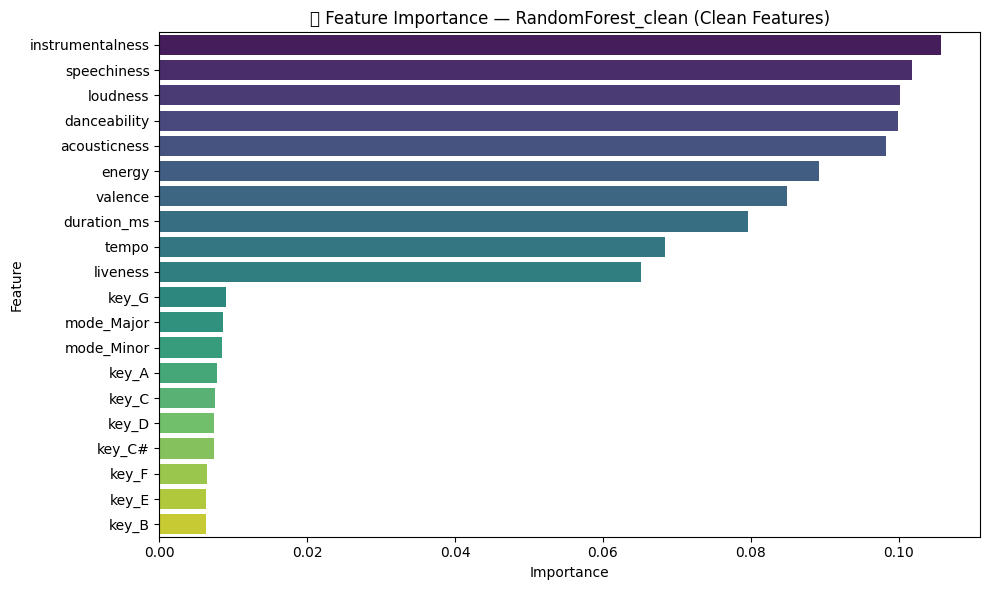

🔁 Обучение моделей (Clean Features): 100%|██████████| 4/4 [19:21<00:00, 290.31s/it]


In [20]:
# RUNNING CHOSEN MODELS USING GRID SEARCH (using a validation split from the training data)
# on the CLEANED data before feature engineering

accuracies_gridsearch_clean = {}
times_gridsearch_clean = {}

# Define categorical and numerical features for the clean data
categorical_cols_clean = ['mode', 'key', 'obtained_date']
numerical_cols_clean = df_train_clean_base.select_dtypes(include=['int64', 'float64']).columns.tolist()
numerical_cols_clean = [col for col in numerical_cols_clean if col not in categorical_cols_clean and col != 'music_genre']

# Create PREPROCESSOR for the clean features
preprocessor_clean = ColumnTransformer(
    transformers=[
        ('onehot', OneHotEncoder(handle_unknown='ignore'), categorical_cols_clean),
        ('num', StandardScaler(), numerical_cols_clean)
    ],
    remainder='passthrough'
)

def get_feature_names_clean(preprocessor):
    feature_names = []
    if hasattr(preprocessor, 'transformers_'):
        for name, transformer, columns in preprocessor.transformers_:
            if transformer == 'drop' or transformer is None:
                continue
            if hasattr(transformer, 'get_feature_names_out'):
                try:
                    names = transformer.get_feature_names_out(columns)
                except:
                     names = columns
            else:
                names = columns
            feature_names.extend(names)
    return feature_names

def plot_feature_importance_clean(pipeline, model_name, top_n=20):
    try:
        model = pipeline.named_steps['classifier']
        preproc = pipeline.named_steps['preprocessor']
        feature_names = get_feature_names_clean(preproc)

        if hasattr(model, 'feature_importances_'):
            importances = model.feature_importances_
        elif hasattr(model, 'coef_'):
             if model.coef_.ndim > 1: # Handle multi-class case for linear models
                importances = np.mean(np.abs(model.coef_), axis=0)
             else:
                importances = np.abs(model.coef_)
        else:
            print(f"⚠️ Модель {model_name} не поддерживает оценку важности признаков.")
            return

        importance_df = pd.DataFrame({
            'Feature': feature_names,
            'Importance': importances
        }).sort_values(by='Importance', ascending=False).head(top_n)

        plt.figure(figsize=(10, 6))
        sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
        plt.title(f'🔍 Feature Importance — {model_name} (Clean Features)')
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"❌ Ошибка при построении важности признаков для {model_name}: {e}")
        traceback.print_exc()

# Add models and params for the clean dataset
models_and_params_clean = {
    'LogisticRegression_clean': {
        'model': LogisticRegression(max_iter=1000, random_state=RANDOM_STATE),
        'params': {
            'classifier__C': [0.01, 0.1, 1, 10],
            'classifier__penalty': ['l2'],
            'classifier__solver': ['lbfgs']
        }
    },
    'SVM_clean': {
        'model': SVC(probability=True, random_state=RANDOM_STATE),
        'params': {
            'classifier__C': [0.1, 1, 10],
            'classifier__kernel': ['linear', 'rbf']
        }
    },
    'DecisionTree_clean': {
        'model': DecisionTreeClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__max_depth': [5, 10, 20],
            'classifier__min_samples_split': [2, 5]
        }
    },
    'RandomForest_clean': {
        'model': RandomForestClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__n_estimators': [50, 100],
            'classifier__max_depth': [10, 20]
        }
    }
}


for name, mp in tqdm(models_and_params_clean.items(), desc="🔁 Обучение моделей (Clean Features)"):
    print(f"\n🔍 Tuning {name} (Clean Features)...")

    try:
        # ⏱️ Старт замера времени
        start_time = time.time()

        # Делим тренировочные данные на тренировочную и валидационную выборки
        X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
            df_train_clean_base.drop('music_genre', axis=1), y_train, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y_train
        )

        # Label encode the target variable
        label_encoder = LabelEncoder()
        y_train_split_encoded = label_encoder.fit_transform(y_train_split)
        y_val_split_encoded = label_encoder.transform(y_val_split)


        pipeline = Pipeline([
            ('preprocessor', preprocessor_clean),  # Use the clean preprocessor
            ('classifier', mp['model'])
        ])

        grid = GridSearchCV(
            estimator=pipeline,
            param_grid=mp['params'],
            cv=3,
            scoring='accuracy',
            n_jobs=-1,
            verbose=1
        )

        grid.fit(X_train_split, y_train_split_encoded)
        y_pred_val = grid.predict(X_val_split)

        # ⏱️ Окончание замера времени
        elapsed_time = time.time() - start_time
        times_gridsearch_clean[name] = elapsed_time

        acc = accuracy_score(y_val_split_encoded, y_pred_val)

        print(f"\n✅ Best parameters for {name}: {grid.best_params_}")
        print(f"✅ Accuracy on validation set for {name}: {acc:.4f}")
        print(f"🕒 Training time for {name}: {elapsed_time:.2f} seconds")
        print(f"📋 Classification Report:\n{classification_report(y_val_split_encoded, y_pred_val)}")

        # Сохраняем точность
        accuracies_gridsearch_clean[name] = acc

        # Сохраняем grid.cv_results_ как CSV
        cv_results_df = pd.DataFrame(grid.cv_results_)
        csv_filename = f"{name}_clean_cv_results.csv"
        cv_results_df.to_csv(csv_filename, index=False)
        print(f"💾 Grid search results saved to: {csv_filename}")

        # 🔍 Показываем важность признаков
        best_pipeline = grid.best_estimator_
        plot_feature_importance_clean(best_pipeline, model_name=name)


    except Exception as e:
        print(f"\n❌ Ошибка при обучении модели {name}: {e}")
        traceback.print_exc()
        continue

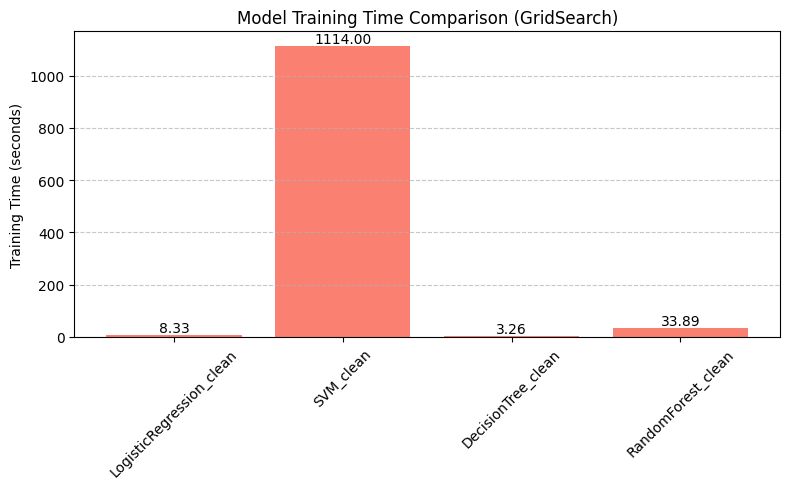

In [21]:
# PLOT RUNNING TIMES  FOR GRIDSEARCH
plt.figure(figsize=(8, 5))
bars = plt.bar(times_gridsearch_clean.keys(), times_gridsearch_clean.values(), color='salmon')

plt.ylabel('Training Time (seconds)')
plt.title('Model Training Time Comparison (GridSearch)')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45)

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2.0, yval, f"{yval:.2f}", va='bottom', ha='center') # Add labels

plt.tight_layout()
plt.show()

## Поиск решения с помощью GridSearch

🔁 Обучение моделей:   0%|          | 0/8 [00:00<?, ?it/s]


🔍 Tuning LogisticRegression...
Fitting 3 folds for each of 4 candidates, totalling 12 fits

✅ Best parameters for LogisticRegression: {'classifier__C': 10, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}
✅ Accuracy on validation set for LogisticRegression: 0.4046
🕒 Training time for LogisticRegression: 2.91 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.24      0.29      0.26       498
           1       0.34      0.18      0.23       379
           2       0.39      0.51      0.44       564
           3       0.77      0.81      0.79       274
           4       0.35      0.57      0.43       418
           5       0.54      0.54      0.54       510
           6       0.00      0.00      0.00       213
           7       0.40      0.21      0.27       245
           8       0.41      0.63      0.50       462
           9       0.26      0.07      0.11       409

    accuracy                           0.40      

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


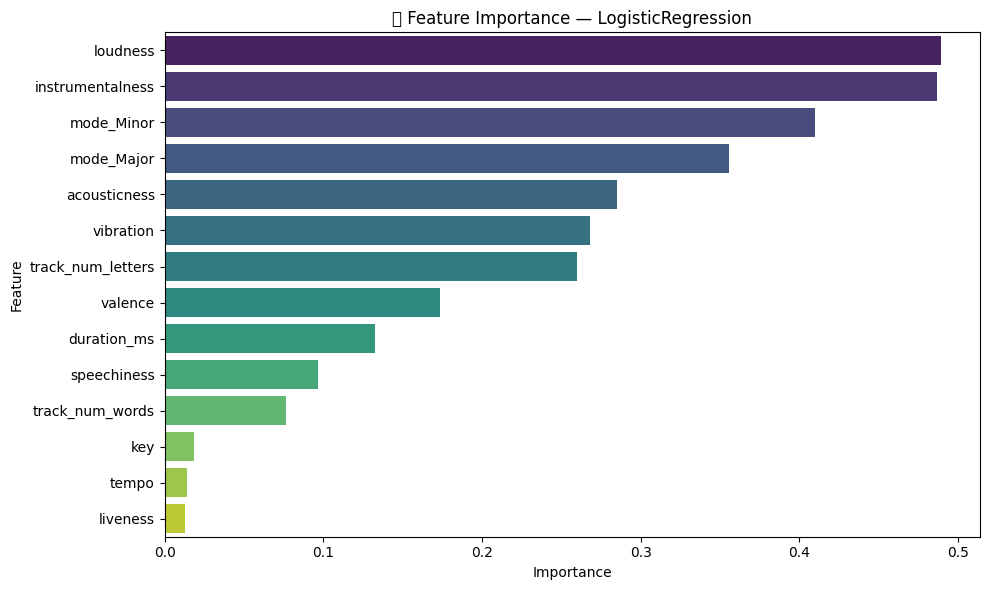

🔁 Обучение моделей:  12%|█▎        | 1/8 [00:03<00:23,  3.38s/it]


🔍 Tuning SVM...
Fitting 3 folds for each of 6 candidates, totalling 18 fits


🔁 Обучение моделей:  25%|██▌       | 2/8 [14:53<52:31, 525.26s/it]


✅ Best parameters for SVM: {'classifier__C': 1, 'classifier__kernel': 'rbf'}
✅ Accuracy on validation set for SVM: 0.4481
🕒 Training time for SVM: 890.57 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.27      0.39      0.32       498
           1       0.58      0.49      0.53       379
           2       0.44      0.54      0.48       564
           3       0.79      0.80      0.79       274
           4       0.38      0.51      0.44       418
           5       0.58      0.60      0.59       510
           6       0.00      0.00      0.00       213
           7       0.39      0.20      0.27       245
           8       0.41      0.65      0.50       462
           9       0.27      0.04      0.06       409

    accuracy                           0.45      3972
   macro avg       0.41      0.42      0.40      3972
weighted avg       0.42      0.45      0.42      3972

💾 Grid search results saved to: SVM_cv_results.csv
⚠️

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


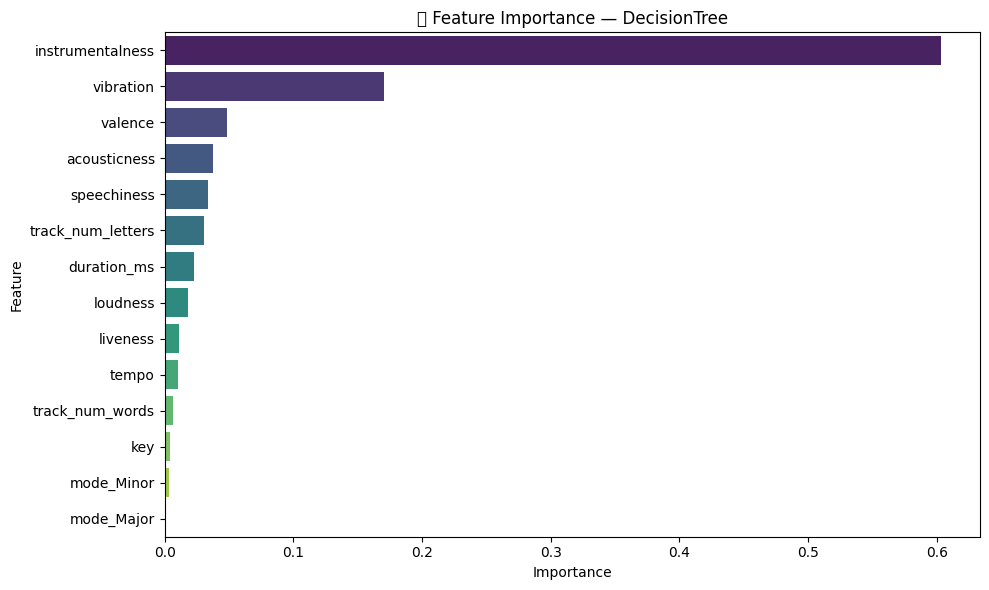

🔁 Обучение моделей:  38%|███▊      | 3/8 [14:57<23:54, 286.99s/it]


🔍 Tuning RandomForest...
Fitting 3 folds for each of 4 candidates, totalling 12 fits

✅ Best parameters for RandomForest: {'classifier__max_depth': 20, 'classifier__n_estimators': 100}
✅ Accuracy on validation set for RandomForest: 0.5735
🕒 Training time for RandomForest: 35.36 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.47      0.53      0.50       498
           1       0.71      0.59      0.64       379
           2       0.49      0.62      0.55       564
           3       0.81      0.82      0.81       274
           4       0.68      0.69      0.68       418
           5       0.55      0.70      0.62       510
           6       0.30      0.05      0.09       213
           7       0.49      0.32      0.39       245
           8       0.60      0.71      0.65       462
           9       0.55      0.36      0.44       409

    accuracy                           0.57      3972
   macro avg       0.56      0.54    

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


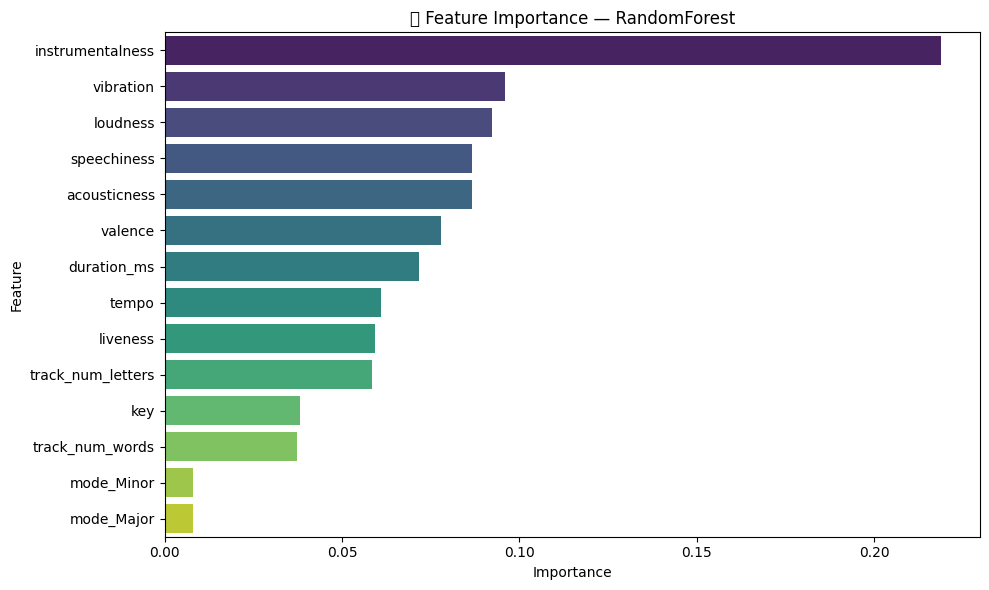

🔁 Обучение моделей:  50%|█████     | 4/8 [15:33<12:32, 188.11s/it]


🔍 Tuning GradientBoosting...
Fitting 3 folds for each of 8 candidates, totalling 24 fits

✅ Best parameters for GradientBoosting: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__n_estimators': 100}
✅ Accuracy on validation set for GradientBoosting: 0.5906
🕒 Training time for GradientBoosting: 999.59 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.51      0.54      0.52       498
           1       0.71      0.64      0.67       379
           2       0.51      0.65      0.57       564
           3       0.81      0.80      0.80       274
           4       0.68      0.72      0.70       418
           5       0.58      0.66      0.62       510
           6       0.22      0.04      0.07       213
           7       0.45      0.38      0.41       245
           8       0.60      0.75      0.67       462
           9       0.63      0.40      0.49       409

    accuracy                           0.

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


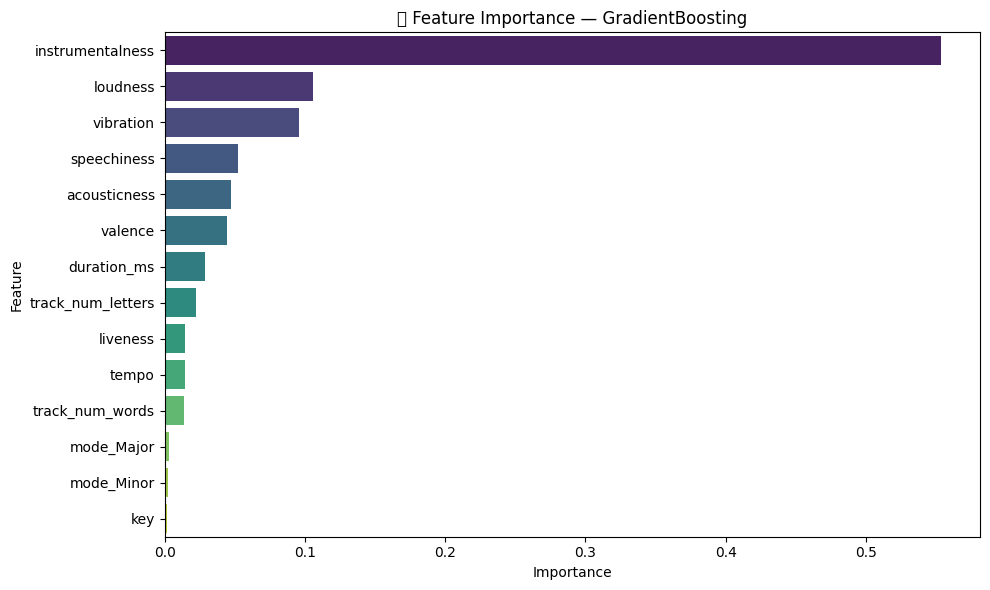

🔁 Обучение моделей:  62%|██████▎   | 5/8 [32:14<24:02, 480.98s/it]


🔍 Tuning XGBoost...
Fitting 3 folds for each of 4 candidates, totalling 12 fits


/usr/local/lib/python3.12/dist-packages/xgboost/training.py:183: UserWarning: [10:57:14] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



✅ Best parameters for XGBoost: {'classifier__max_depth': 6, 'classifier__n_estimators': 100}
✅ Accuracy on validation set for XGBoost: 0.5856
🕒 Training time for XGBoost: 51.09 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.50      0.53      0.51       498
           1       0.72      0.63      0.67       379
           2       0.51      0.64      0.57       564
           3       0.82      0.82      0.82       274
           4       0.68      0.70      0.69       418
           5       0.61      0.68      0.64       510
           6       0.28      0.15      0.19       213
           7       0.49      0.38      0.43       245
           8       0.59      0.68      0.63       462
           9       0.52      0.39      0.45       409

    accuracy                           0.59      3972
   macro avg       0.57      0.56      0.56      3972
weighted avg       0.58      0.59      0.58      3972

💾 Grid search results saved to

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


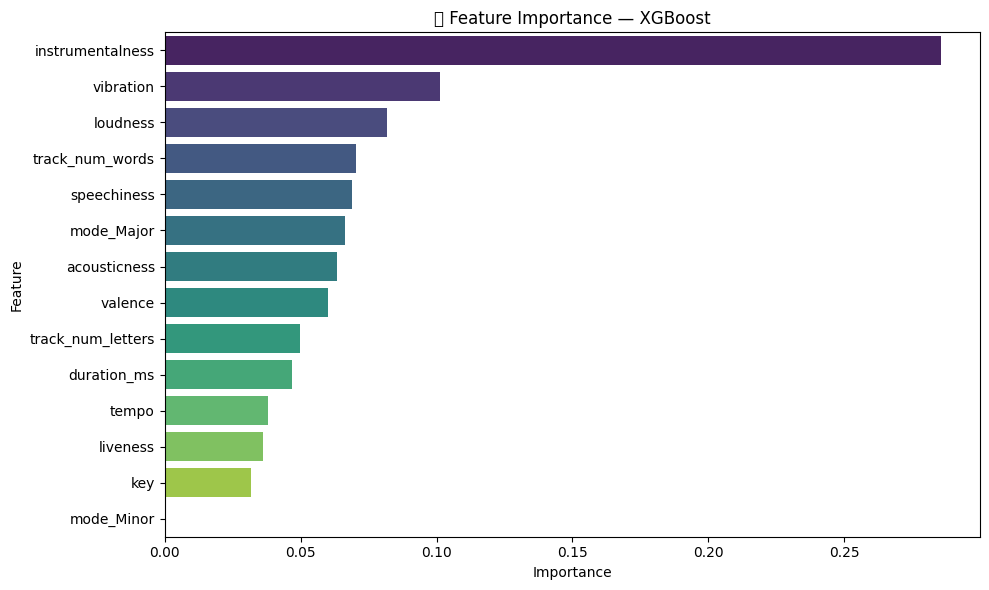

🔁 Обучение моделей:  75%|███████▌  | 6/8 [33:05<11:09, 334.96s/it]


🔍 Tuning CatBoost...
Fitting 3 folds for each of 4 candidates, totalling 12 fits


/usr/local/lib/python3.12/dist-packages/joblib/externals/loky/process_executor.py:782: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(



✅ Best parameters for CatBoost: {'classifier__depth': 6, 'classifier__learning_rate': 0.1}
✅ Accuracy on validation set for CatBoost: 0.5949
🕒 Training time for CatBoost: 2658.64 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.51      0.52      0.51       498
           1       0.69      0.67      0.68       379
           2       0.52      0.64      0.58       564
           3       0.83      0.80      0.81       274
           4       0.67      0.72      0.70       418
           5       0.61      0.68      0.64       510
           6       0.30      0.10      0.15       213
           7       0.51      0.38      0.44       245
           8       0.59      0.73      0.65       462
           9       0.56      0.42      0.48       409

    accuracy                           0.59      3972
   macro avg       0.58      0.57      0.56      3972
weighted avg       0.58      0.59      0.58      3972

💾 Grid search results saved 

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


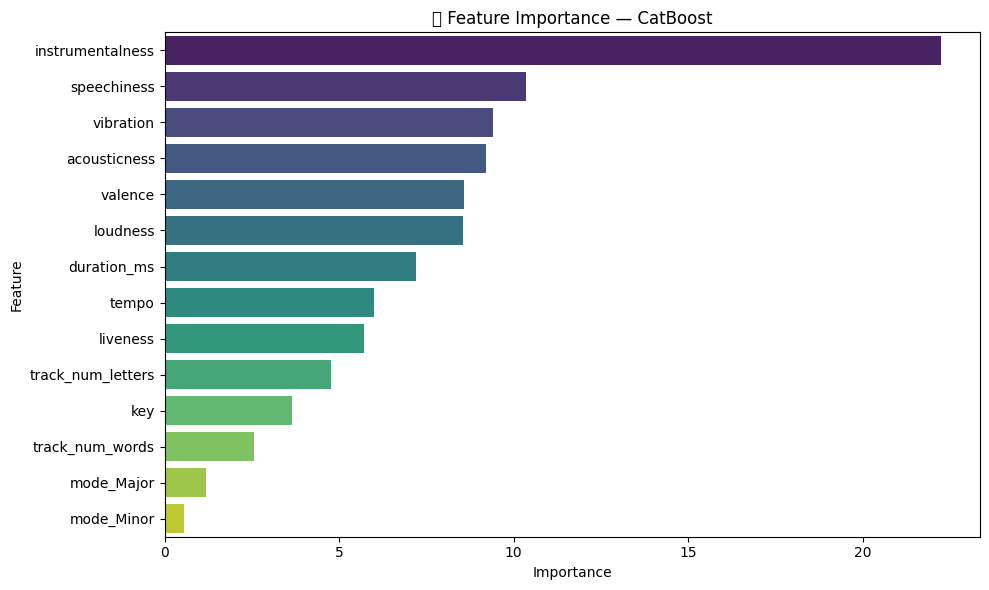

🔁 Обучение моделей:  88%|████████▊ | 7/8 [1:17:24<18:14, 1094.77s/it]


🔍 Tuning ModifiedCatBoost...
Fitting 3 folds for each of 72 candidates, totalling 216 fits

✅ Best parameters for ModifiedCatBoost: {'classifier__depth': 6, 'classifier__iterations': 200, 'classifier__l2_leaf_reg': 1, 'classifier__learning_rate': 0.1}
✅ Accuracy on validation set for ModifiedCatBoost: 0.5957
🕒 Training time for ModifiedCatBoost: 4799.76 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.50      0.52      0.51       498
           1       0.73      0.65      0.69       379
           2       0.52      0.65      0.58       564
           3       0.81      0.80      0.81       274
           4       0.67      0.73      0.70       418
           5       0.57      0.68      0.62       510
           6       0.31      0.02      0.04       213
           7       0.47      0.37      0.41       245
           8       0.59      0.79      0.67       462
           9       0.64      0.40      0.49       409

    accuracy  

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


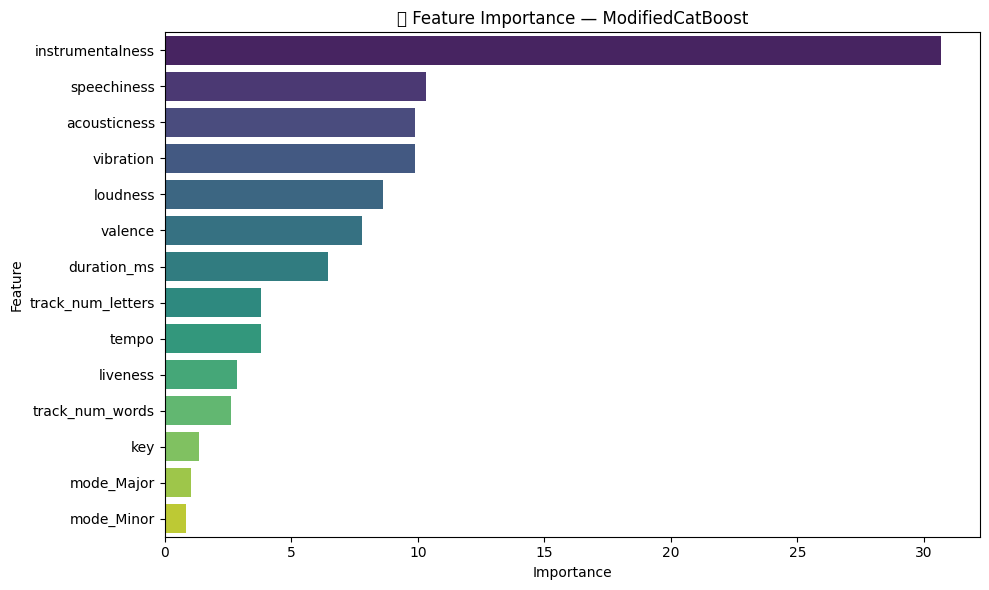

🔁 Обучение моделей: 100%|██████████| 8/8 [2:37:25<00:00, 1180.65s/it]


In [22]:
# LET'S TRY SOME ML MODELS!!
models_and_params = {
    'LogisticRegression': {
        'model': LogisticRegression(max_iter=1000, random_state=RANDOM_STATE),
        'params': {
            'classifier__C': [0.01, 0.1, 1, 10],
            'classifier__penalty': ['l2'],
            'classifier__solver': ['lbfgs']
        }
    },
    'SVM': {
        'model': SVC(probability=True, random_state=RANDOM_STATE),
        'params': {
            'classifier__C': [0.1, 1, 10],
            'classifier__kernel': ['linear', 'rbf']
        }
    },
    'DecisionTree': {
        'model': DecisionTreeClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__max_depth': [5, 10, 20],
            'classifier__min_samples_split': [2, 5]
        }
    },
    'RandomForest': {
        'model': RandomForestClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__n_estimators': [50, 100],
            'classifier__max_depth': [10, 20]
        }
    },
    'GradientBoosting': {
        'model': GradientBoostingClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__n_estimators': [50, 100],
            'classifier__learning_rate': [0.01, 0.1],
            'classifier__max_depth': [3, 5]
        }
    },
    'XGBoost': {
        'model': XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=RANDOM_STATE),
        'params': {
            'classifier__n_estimators': [50, 100],
            'classifier__max_depth': [6, 10]
        }
    },
    'CatBoost': {
        'model': CatBoostClassifier(verbose=0, random_state=RANDOM_STATE),
        'params': {
            'classifier__depth': [6, 10],
            'classifier__learning_rate': [0.01, 0.1]
        }
    },
    'ModifiedCatBoost': {
        'model': CatBoostClassifier(verbose=0, random_state=RANDOM_STATE),
         'params': { 'classifier__iterations': [100, 200],
         'classifier__depth': [4, 6, 10],
         'classifier__learning_rate': [0.01, 0.05, 0.1],
         'classifier__l2_leaf_reg': [1, 3, 5, 7] }
    }
  #  'ModifiedCatBoost_2': {
  #      'model': CatBoostClassifier(verbose=0, random_state=RANDOM_STATE),
  #      'params': {
  #      'classifier__iterations': [100, 200, 300],
  #      'classifier__depth': [4, 6, 10],
  #      'classifier__learning_rate': [0.01, 0.03, 0.05, 0.07, 0.1],
  #      'classifier__l2_leaf_reg': [1, 3, 5, 7, 10],
  #     }
  #  }

}


# RUNNING CHOSEN MODELS USING GRID SEARCH (using a validation split from the training data)

accuracies_gridsearch = {}
times_gridsearch = {}

def get_feature_names(preprocessor):
    feature_names = []
    if hasattr(preprocessor, 'transformers_'):
        for name, transformer, columns in preprocessor.transformers_:
            if transformer == 'drop' or transformer is None:
                continue
            if hasattr(transformer, 'get_feature_names_out'):
                names = transformer.get_feature_names_out(columns)
            else:
                names = columns
            feature_names.extend(names)
    return feature_names


def plot_feature_importance(pipeline, model_name, top_n=20):
    try:
        model = pipeline.named_steps['classifier']
        preproc = pipeline.named_steps['preprocessor']
        feature_names = get_feature_names(preproc)

        if hasattr(model, 'feature_importances_'):
            importances = model.feature_importances_
        elif hasattr(model, 'coef_'):
            importances = np.abs(model.coef_[0])
        else:
            print(f"⚠️ Модель {model_name} не поддерживает оценку важности признаков.")
            return

        importance_df = pd.DataFrame({
            'Feature': feature_names,
            'Importance': importances
        }).sort_values(by='Importance', ascending=False).head(top_n)

        plt.figure(figsize=(10, 6))
        sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
        plt.title(f'🔍 Feature Importance — {model_name}')
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"❌ Ошибка при построении важности признаков для {model_name}: {e}")
        traceback.print_exc()


for name, mp in tqdm(models_and_params.items(), desc="🔁 Обучение моделей"):
    print(f"\n🔍 Tuning {name}...")

    try:
        # ⏱️ Старт замера времени
        start_time = time.time()

        # Делим тренировочные данные на тренировочную и валидационную выборки
        X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
            X_train, y_train, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y_train
        )

        # Label encode the target variable
        label_encoder = LabelEncoder()
        y_train_split_encoded = label_encoder.fit_transform(y_train_split)
        y_val_split_encoded = label_encoder.transform(y_val_split)


        pipeline = Pipeline([
            ('preprocessor', preprocessor),  # preprocessor должен быть определён ранее
            ('classifier', mp['model'])
        ])

        grid = GridSearchCV(
            estimator=pipeline,
            param_grid=mp['params'],
            cv=3,
            scoring='accuracy',
            n_jobs=-1,
            verbose=1
        )

        grid.fit(X_train_split, y_train_split_encoded)
        y_pred_val = grid.predict(X_val_split)

        # ⏱️ Окончание замера времени
        elapsed_time = time.time() - start_time
        times_gridsearch[name] = elapsed_time

        acc = accuracy_score(y_val_split_encoded, y_pred_val)

        print(f"\n✅ Best parameters for {name}: {grid.best_params_}")
        print(f"✅ Accuracy on validation set for {name}: {acc:.4f}")
        print(f"🕒 Training time for {name}: {elapsed_time:.2f} seconds")
        print(f"📋 Classification Report:\n{classification_report(y_val_split_encoded, y_pred_val)}")

        # Сохраняем точность
        accuracies_gridsearch[name] = acc

        # Сохраняем grid.cv_results_ как CSV
        cv_results_df = pd.DataFrame(grid.cv_results_)
        csv_filename = f"{name}_cv_results.csv"
        cv_results_df.to_csv(csv_filename, index=False)
        print(f"💾 Grid search results saved to: {csv_filename}")

        # 🔍 Показываем важность признаков
        best_pipeline = grid.best_estimator_
        plot_feature_importance(best_pipeline, model_name=name)

    except Exception as e:
        print(f"\n❌ Ошибка при обучении модели {name}: {e}")
        traceback.print_exc()
        continue


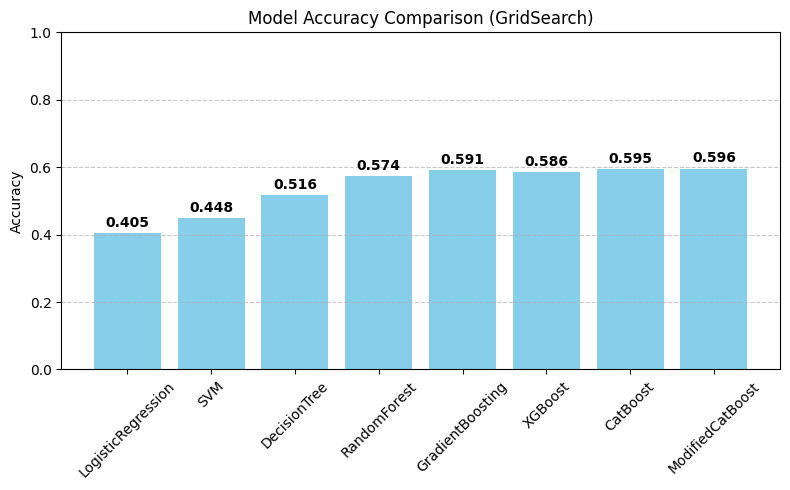

In [23]:
# PLOT ACCURACIES WITH LABELS FOR GRIDSEARCH
plt.figure(figsize=(8, 5))
bars = plt.bar(accuracies_gridsearch.keys(), accuracies_gridsearch.values(), color='skyblue')

plt.ylabel('Accuracy')
plt.title('Model Accuracy Comparison (GridSearch)')
plt.ylim(0, 1)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45)

for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height + 0.01,
        f"{height:.3f}",
        ha='center',
        va='bottom',
        fontsize=10,
        fontweight='bold'
    )

plt.tight_layout()
plt.show()

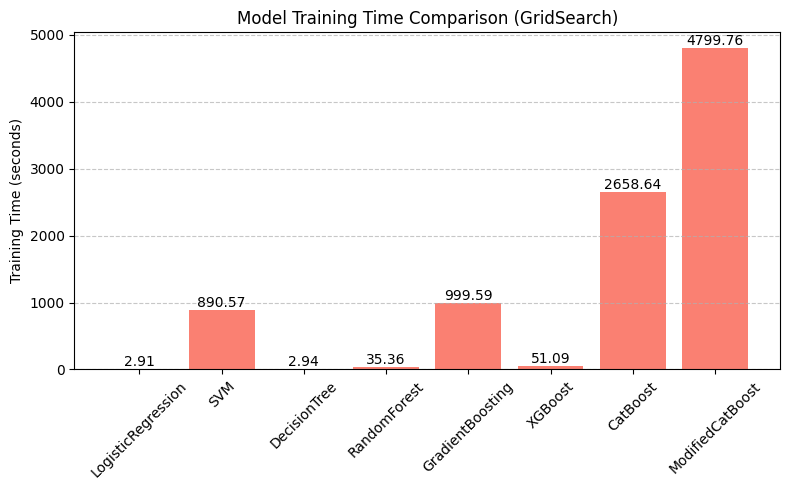

In [24]:
# PLOT RUNNING TIMES  FOR GRIDSEARCH
plt.figure(figsize=(8, 5))
bars = plt.bar(times_gridsearch.keys(), times_gridsearch.values(), color='salmon')

plt.ylabel('Training Time (seconds)')
plt.title('Model Training Time Comparison (GridSearch)')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45)

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2.0, yval, f"{yval:.2f}", va='bottom', ha='center') # Add labels

plt.tight_layout()
plt.show()

## Поиск решения с помощью Optuna

🔁 Обучение моделей:   0%|          | 0/7 [00:00<?, ?it/s]/tmp/ipython-input-240837704.py:86: ExperimentalWarning: OptunaSearchCV is experimental (supported from v0.17.0). The interface can change in the future.
  optuna_search = OptunaSearchCV(
[I 2025-09-30 13:01:39,493] A new study created in memory with name: no-name-9a9477c5-e890-4f04-9cfd-24eef508b89e
INFO:optuna_integration.sklearn.sklearn:Searching the best hyperparameters using 15887 samples...



🔍 Tuning LogisticRegression with Optuna...


[I 2025-09-30 13:01:40,971] Trial 1 finished with value: 0.38836819968295533 and parameters: {'classifier__C': 0.0019976087069520313, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}. Best is trial 1 with value: 0.38836819968295533.
[I 2025-09-30 13:01:42,715] Trial 0 finished with value: 0.4119723213580997 and parameters: {'classifier__C': 2.902278369356082, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}. Best is trial 0 with value: 0.4119723213580997.
[I 2025-09-30 13:01:43,367] Trial 2 finished with value: 0.40769213579095215 and parameters: {'classifier__C': 0.05675278542760861, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}. Best is trial 0 with value: 0.4119723213580997.
[I 2025-09-30 13:01:44,498] Trial 4 finished with value: 0.3765976923449985 and parameters: {'classifier__C': 0.001058312652287906, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}. Best is trial 0 with value: 0.4119723213580997.
[I 2025-09-30 13:01:45,843] Trial 3 


✅ Best parameters for LogisticRegression: {'classifier__C': 9.05702211897533, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs'}
✅ Accuracy on validation set for LogisticRegression: 0.4043
🕒 Training time for LogisticRegression: 61.63 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.24      0.29      0.26       498
           1       0.34      0.18      0.23       379
           2       0.39      0.51      0.44       564
           3       0.77      0.81      0.79       274
           4       0.35      0.57      0.43       418
           5       0.54      0.54      0.54       510
           6       0.00      0.00      0.00       213
           7       0.40      0.21      0.27       245
           8       0.41      0.63      0.50       462
           9       0.25      0.06      0.10       409

    accuracy                           0.40      3972
   macro avg       0.37      0.38      0.36      3972
weighted avg      

/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


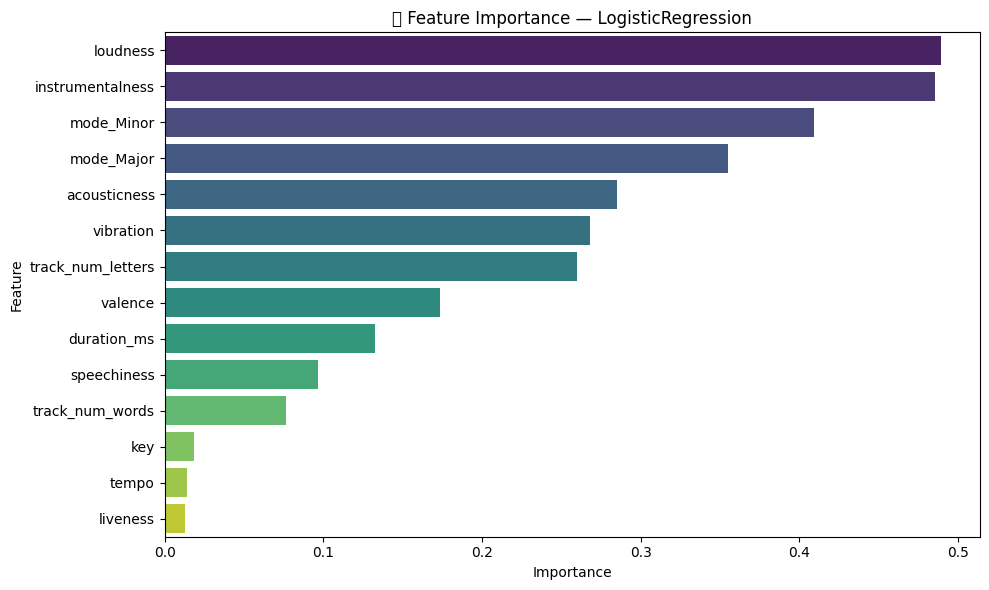

🔁 Обучение моделей:  14%|█▍        | 1/7 [01:02<06:13, 62.17s/it]/tmp/ipython-input-240837704.py:86: ExperimentalWarning: OptunaSearchCV is experimental (supported from v0.17.0). The interface can change in the future.
  optuna_search = OptunaSearchCV(
[I 2025-09-30 13:02:41,660] A new study created in memory with name: no-name-84a5d409-7a0c-4b7a-8ef9-91dd4f8f173e
INFO:optuna_integration.sklearn.sklearn:Searching the best hyperparameters using 15887 samples...



🔍 Tuning SVM with Optuna...


[I 2025-09-30 13:05:12,189] Trial 1 finished with value: 0.40529997755772945 and parameters: {'classifier__C': 0.03888370073607765, 'classifier__kernel': 'linear'}. Best is trial 1 with value: 0.40529997755772945.
[I 2025-09-30 13:06:58,754] Trial 0 finished with value: 0.4037267363518187 and parameters: {'classifier__C': 0.07036897920145713, 'classifier__kernel': 'rbf'}. Best is trial 1 with value: 0.40529997755772945.
[I 2025-09-30 13:15:23,926] Trial 3 finished with value: 0.40523710829441595 and parameters: {'classifier__C': 99.69468634232082, 'classifier__kernel': 'rbf'}. Best is trial 1 with value: 0.40529997755772945.
[I 2025-09-30 13:18:41,387] Trial 4 finished with value: 0.4080694108048121 and parameters: {'classifier__C': 0.9327425600245359, 'classifier__kernel': 'linear'}. Best is trial 4 with value: 0.4080694108048121.
[I 2025-09-30 13:21:13,074] Trial 5 finished with value: 0.4078805771657505 and parameters: {'classifier__C': 0.27855652960926375, 'classifier__kernel': 'li


✅ Best parameters for SVM: {'classifier__C': 2.2746016272562124, 'classifier__kernel': 'rbf'}
✅ Accuracy on validation set for SVM: 0.4527
🕒 Training time for SVM: 6728.16 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.28      0.38      0.32       498
           1       0.56      0.52      0.54       379
           2       0.44      0.53      0.48       564
           3       0.79      0.79      0.79       274
           4       0.40      0.51      0.45       418
           5       0.59      0.60      0.60       510
           6       0.00      0.00      0.00       213
           7       0.43      0.22      0.29       245
           8       0.41      0.65      0.50       462
           9       0.25      0.04      0.07       409

    accuracy                           0.45      3972
   macro avg       0.42      0.43      0.41      3972
weighted avg       0.42      0.45      0.42      3972

💾 Optuna results saved to: SVM_optu

[I 2025-09-30 14:54:50,299] Trial 1 finished with value: 0.3640079470362414 and parameters: {'classifier__max_depth': 4, 'classifier__min_samples_split': 10}. Best is trial 1 with value: 0.3640079470362414.
[I 2025-09-30 14:54:50,643] Trial 0 finished with value: 0.5065148556419964 and parameters: {'classifier__max_depth': 9, 'classifier__min_samples_split': 5}. Best is trial 0 with value: 0.5065148556419964.
[I 2025-09-30 14:54:50,996] Trial 3 finished with value: 0.31535210591230206 and parameters: {'classifier__max_depth': 3, 'classifier__min_samples_split': 10}. Best is trial 0 with value: 0.5065148556419964.
[I 2025-09-30 14:54:51,196] Trial 2 finished with value: 0.5100395640113468 and parameters: {'classifier__max_depth': 11, 'classifier__min_samples_split': 2}. Best is trial 2 with value: 0.5100395640113468.
[I 2025-09-30 14:54:52,009] Trial 4 finished with value: 0.49669575603349986 and parameters: {'classifier__max_depth': 14, 'classifier__min_samples_split': 10}. Best is tri


✅ Best parameters for DecisionTree: {'classifier__max_depth': 12, 'classifier__min_samples_split': 5}
✅ Accuracy on validation set for DecisionTree: 0.5191
🕒 Training time for DecisionTree: 15.14 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.43      0.48      0.45       498
           1       0.59      0.54      0.56       379
           2       0.42      0.54      0.47       564
           3       0.79      0.74      0.76       274
           4       0.66      0.67      0.66       418
           5       0.55      0.54      0.54       510
           6       0.28      0.13      0.17       213
           7       0.38      0.35      0.36       245
           8       0.57      0.60      0.58       462
           9       0.48      0.42      0.45       409

    accuracy                           0.52      3972
   macro avg       0.51      0.50      0.50      3972
weighted avg       0.52      0.52      0.51      3972

💾 Optuna re

/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


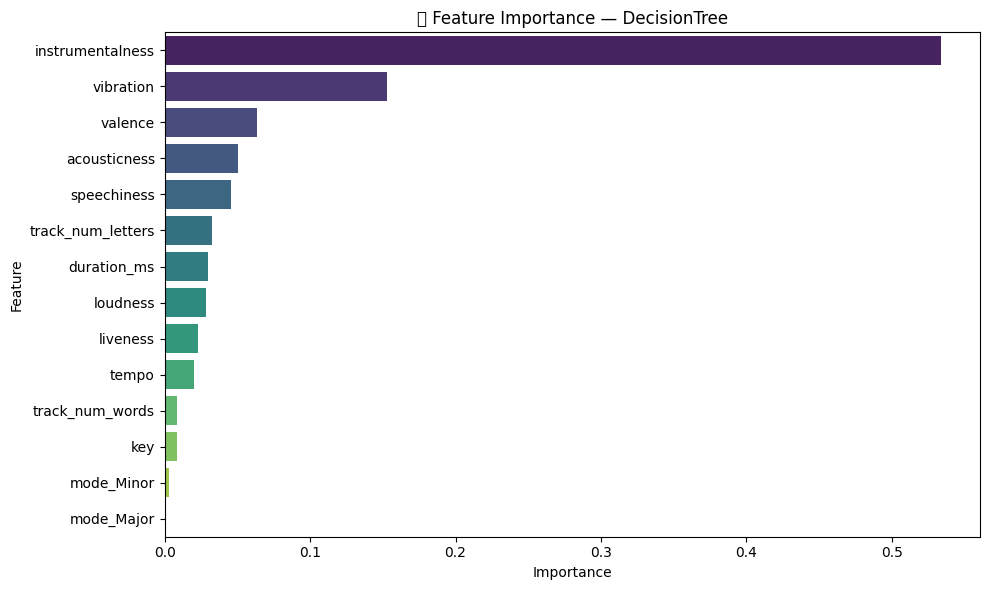

🔁 Обучение моделей:  43%|████▎     | 3/7 [1:53:25<2:24:46, 2171.61s/it]/tmp/ipython-input-240837704.py:86: ExperimentalWarning: OptunaSearchCV is experimental (supported from v0.17.0). The interface can change in the future.
  optuna_search = OptunaSearchCV(
[I 2025-09-30 14:55:05,464] A new study created in memory with name: no-name-874329fb-fc4d-4a5f-b9e3-fd7f5aaaf5bb
INFO:optuna_integration.sklearn.sklearn:Searching the best hyperparameters using 15887 samples...



🔍 Tuning RandomForest with Optuna...


[I 2025-09-30 14:55:27,426] Trial 1 finished with value: 0.5570590450433488 and parameters: {'classifier__n_estimators': 97, 'classifier__max_depth': 27}. Best is trial 1 with value: 0.5570590450433488.
[I 2025-09-30 14:55:43,699] Trial 2 finished with value: 0.5073326434237015 and parameters: {'classifier__n_estimators': 141, 'classifier__max_depth': 8}. Best is trial 1 with value: 0.5570590450433488.
[I 2025-09-30 14:55:50,029] Trial 0 finished with value: 0.5593882151452995 and parameters: {'classifier__n_estimators': 200, 'classifier__max_depth': 29}. Best is trial 0 with value: 0.5593882151452995.
[I 2025-09-30 14:56:04,355] Trial 3 finished with value: 0.5547299938093567 and parameters: {'classifier__n_estimators': 98, 'classifier__max_depth': 20}. Best is trial 0 with value: 0.5593882151452995.
[I 2025-09-30 14:56:11,115] Trial 4 finished with value: 0.5569959380441181 and parameters: {'classifier__n_estimators': 89, 'classifier__max_depth': 22}. Best is trial 0 with value: 0.55


✅ Best parameters for RandomForest: {'classifier__n_estimators': 184, 'classifier__max_depth': 19}
✅ Accuracy on validation set for RandomForest: 0.5783
🕒 Training time for RandomForest: 478.86 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.46      0.54      0.50       498
           1       0.69      0.60      0.64       379
           2       0.48      0.64      0.55       564
           3       0.82      0.82      0.82       274
           4       0.69      0.68      0.69       418
           5       0.56      0.68      0.61       510
           6       0.30      0.03      0.06       213
           7       0.55      0.33      0.41       245
           8       0.61      0.73      0.67       462
           9       0.57      0.37      0.45       409

    accuracy                           0.58      3972
   macro avg       0.57      0.54      0.54      3972
weighted avg       0.57      0.58      0.56      3972

💾 Optuna resu

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


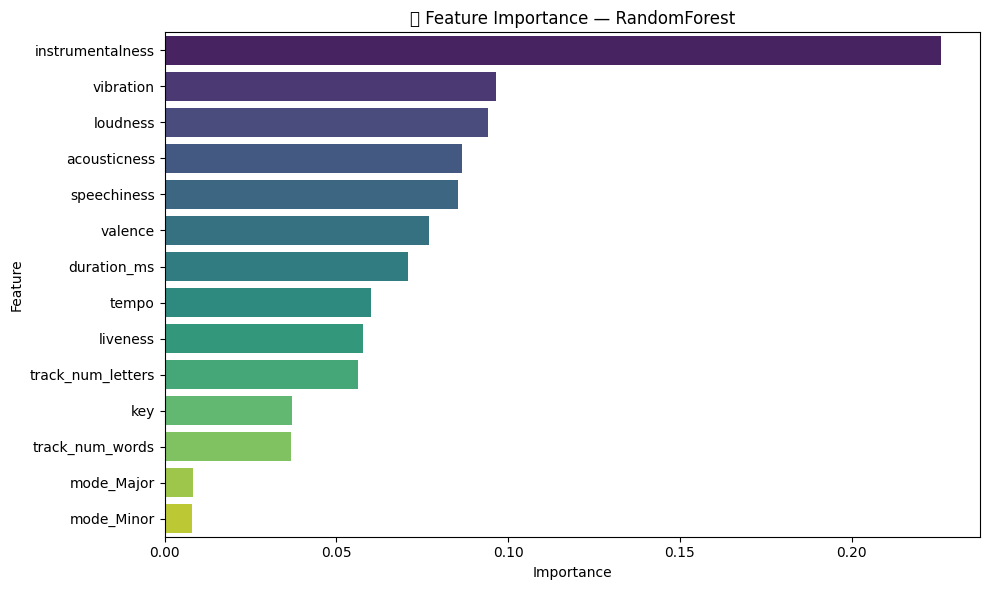

🔁 Обучение моделей:  57%|█████▋    | 4/7 [2:01:25<1:15:10, 1503.56s/it]/tmp/ipython-input-240837704.py:86: ExperimentalWarning: OptunaSearchCV is experimental (supported from v0.17.0). The interface can change in the future.
  optuna_search = OptunaSearchCV(
[I 2025-09-30 15:03:04,911] A new study created in memory with name: no-name-5905dc96-d850-480d-a361-72847870bc9c
INFO:optuna_integration.sklearn.sklearn:Searching the best hyperparameters using 15887 samples...



🔍 Tuning GradientBoosting with Optuna...


[I 2025-09-30 15:09:12,304] Trial 1 finished with value: 0.5661859408684208 and parameters: {'classifier__n_estimators': 63, 'classifier__learning_rate': 0.01758259088396896, 'classifier__max_depth': 7}. Best is trial 1 with value: 0.5661859408684208.
[I 2025-09-30 15:19:40,275] Trial 2 finished with value: 0.5746205497024972 and parameters: {'classifier__n_estimators': 134, 'classifier__learning_rate': 0.06420124627597289, 'classifier__max_depth': 6}. Best is trial 2 with value: 0.5746205497024972.
[I 2025-09-30 15:21:28,077] Trial 0 finished with value: 0.5581293440295477 and parameters: {'classifier__n_estimators': 118, 'classifier__learning_rate': 0.03142640214745559, 'classifier__max_depth': 10}. Best is trial 2 with value: 0.5746205497024972.
[I 2025-09-30 15:28:10,345] Trial 3 finished with value: 0.5741802627837734 and parameters: {'classifier__n_estimators': 90, 'classifier__learning_rate': 0.039035365480741956, 'classifier__max_depth': 7}. Best is trial 2 with value: 0.574620


✅ Best parameters for GradientBoosting: {'classifier__n_estimators': 86, 'classifier__learning_rate': 0.0780341333174984, 'classifier__max_depth': 4}
✅ Accuracy on validation set for GradientBoosting: 0.5884
🕒 Training time for GradientBoosting: 7922.91 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.50      0.52      0.51       498
           1       0.69      0.64      0.66       379
           2       0.51      0.64      0.57       564
           3       0.79      0.79      0.79       274
           4       0.69      0.72      0.70       418
           5       0.59      0.68      0.63       510
           6       0.31      0.08      0.13       213
           7       0.47      0.39      0.42       245
           8       0.60      0.74      0.66       462
           9       0.59      0.38      0.46       409

    accuracy                           0.59      3972
   macro avg       0.57      0.56      0.55      3972
weighted

/tmp/ipython-input-1581997632.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=importance_df, x='Importance', y='Feature', palette='viridis')
/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


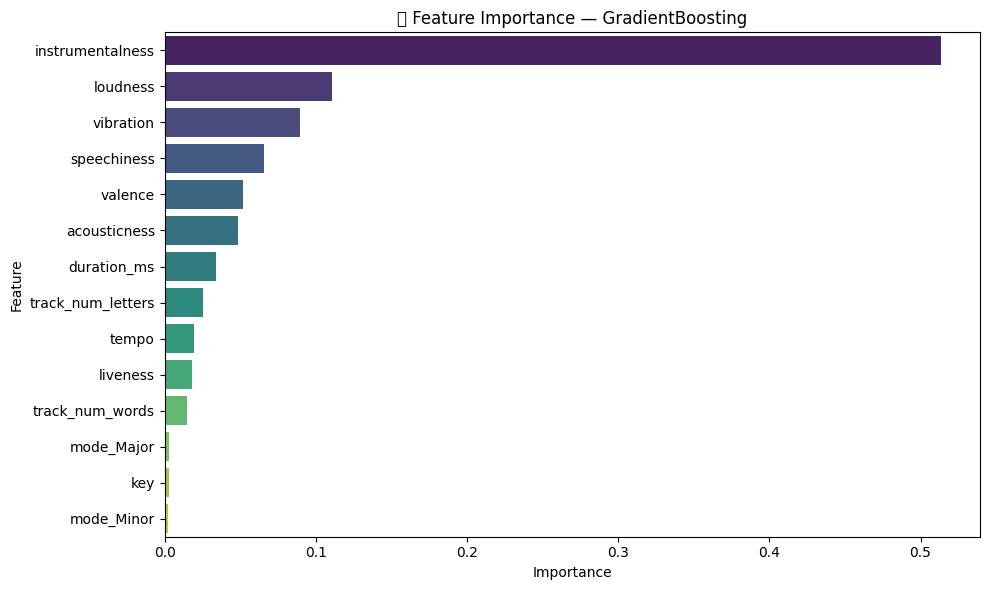

🔁 Обучение моделей:  71%|███████▏  | 5/7 [4:13:28<2:07:17, 3818.63s/it]/tmp/ipython-input-240837704.py:86: ExperimentalWarning: OptunaSearchCV is experimental (supported from v0.17.0). The interface can change in the future.
  optuna_search = OptunaSearchCV(
[I 2025-09-30 17:15:08,424] A new study created in memory with name: no-name-fed65bc3-380d-49fa-93a2-f9960da15b1e
INFO:optuna_integration.sklearn.sklearn:Searching the best hyperparameters using 15887 samples...



🔍 Tuning XGBoost with Optuna...


[I 2025-09-30 17:15:15,378] Trial 0 finished with value: 0.5829922536128728 and parameters: {'classifier__n_estimators': 82, 'classifier__max_depth': 3}. Best is trial 0 with value: 0.5829922536128728.
[I 2025-09-30 17:15:24,913] Trial 2 finished with value: 0.5785232344066634 and parameters: {'classifier__n_estimators': 52, 'classifier__max_depth': 5}. Best is trial 0 with value: 0.5829922536128728.
[I 2025-09-30 17:15:35,620] Trial 1 finished with value: 0.570151364081146 and parameters: {'classifier__n_estimators': 128, 'classifier__max_depth': 6}. Best is trial 0 with value: 0.5829922536128728.
[I 2025-09-30 17:15:45,663] Trial 3 finished with value: 0.5736763933939845 and parameters: {'classifier__n_estimators': 161, 'classifier__max_depth': 4}. Best is trial 0 with value: 0.5829922536128728.
[I 2025-09-30 17:16:07,792] Trial 5 finished with value: 0.5707809957711535 and parameters: {'classifier__n_estimators': 184, 'classifier__max_depth': 4}. Best is trial 0 with value: 0.582992


✅ Best parameters for XGBoost: {'classifier__n_estimators': 118, 'classifier__max_depth': 3}
✅ Accuracy on validation set for XGBoost: 0.6037
🕒 Training time for XGBoost: 286.39 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.55      0.54      0.55       498
           1       0.72      0.65      0.68       379
           2       0.51      0.67      0.58       564
           3       0.82      0.83      0.83       274
           4       0.68      0.72      0.70       418
           5       0.60      0.69      0.64       510
           6       0.34      0.10      0.16       213
           7       0.49      0.40      0.44       245
           8       0.59      0.74      0.66       462
           9       0.63      0.39      0.48       409

    accuracy                           0.60      3972
   macro avg       0.59      0.57      0.57      3972
weighted avg       0.60      0.60      0.59      3972

💾 Optuna results saved to: XG

/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


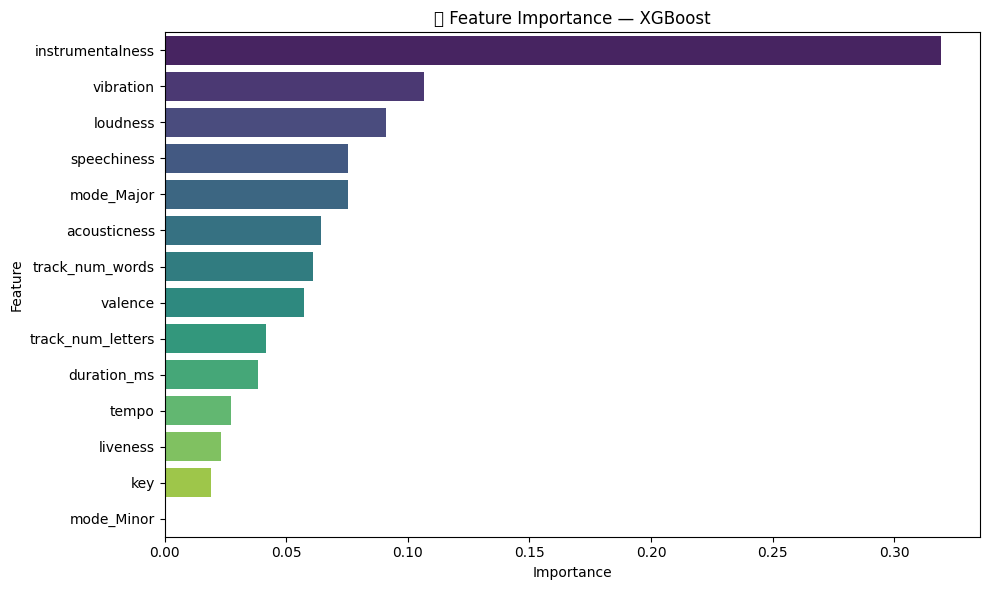

🔁 Обучение моделей:  86%|████████▌ | 6/7 [4:18:15<43:37, 2617.82s/it]  /tmp/ipython-input-240837704.py:86: ExperimentalWarning: OptunaSearchCV is experimental (supported from v0.17.0). The interface can change in the future.
  optuna_search = OptunaSearchCV(
[I 2025-09-30 17:19:55,249] A new study created in memory with name: no-name-2d7c934c-b688-4195-9c8e-d448683e6577
INFO:optuna_integration.sklearn.sklearn:Searching the best hyperparameters using 15887 samples...



🔍 Tuning CatBoost with Optuna...


[I 2025-09-30 17:22:36,073] Trial 1 finished with value: 0.5879019282284775 and parameters: {'classifier__depth': 5, 'classifier__learning_rate': 0.08450695412909259}. Best is trial 1 with value: 0.5879019282284775.
[I 2025-09-30 17:25:18,544] Trial 2 finished with value: 0.5768239218438417 and parameters: {'classifier__depth': 5, 'classifier__learning_rate': 0.013544724660314865}. Best is trial 1 with value: 0.5879019282284775.
[I 2025-09-30 17:25:56,670] Trial 0 finished with value: 0.5838104812060249 and parameters: {'classifier__depth': 7, 'classifier__learning_rate': 0.017955412782726617}. Best is trial 1 with value: 0.5879019282284775.
[I 2025-09-30 17:27:08,902] Trial 3 finished with value: 0.581607394347781 and parameters: {'classifier__depth': 4, 'classifier__learning_rate': 0.18859177847701872}. Best is trial 1 with value: 0.5879019282284775.
[I 2025-09-30 17:28:27,256] Trial 4 finished with value: 0.5739913815975283 and parameters: {'classifier__depth': 5, 'classifier__learn


✅ Best parameters for CatBoost: {'classifier__depth': 4, 'classifier__learning_rate': 0.06618386346212887}
✅ Accuracy on validation set for CatBoost: 0.6045
🕒 Training time for CatBoost: 6254.87 seconds
📋 Classification Report:
              precision    recall  f1-score   support

           0       0.52      0.53      0.52       498
           1       0.73      0.66      0.70       379
           2       0.53      0.66      0.58       564
           3       0.81      0.81      0.81       274
           4       0.65      0.74      0.69       418
           5       0.59      0.70      0.64       510
           6       0.29      0.02      0.04       213
           7       0.50      0.38      0.43       245
           8       0.59      0.79      0.68       462
           9       0.66      0.40      0.50       409

    accuracy                           0.60      3972
   macro avg       0.59      0.57      0.56      3972
weighted avg       0.59      0.60      0.59      3972

💾 Optuna res

/tmp/ipython-input-1581997632.py:115: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


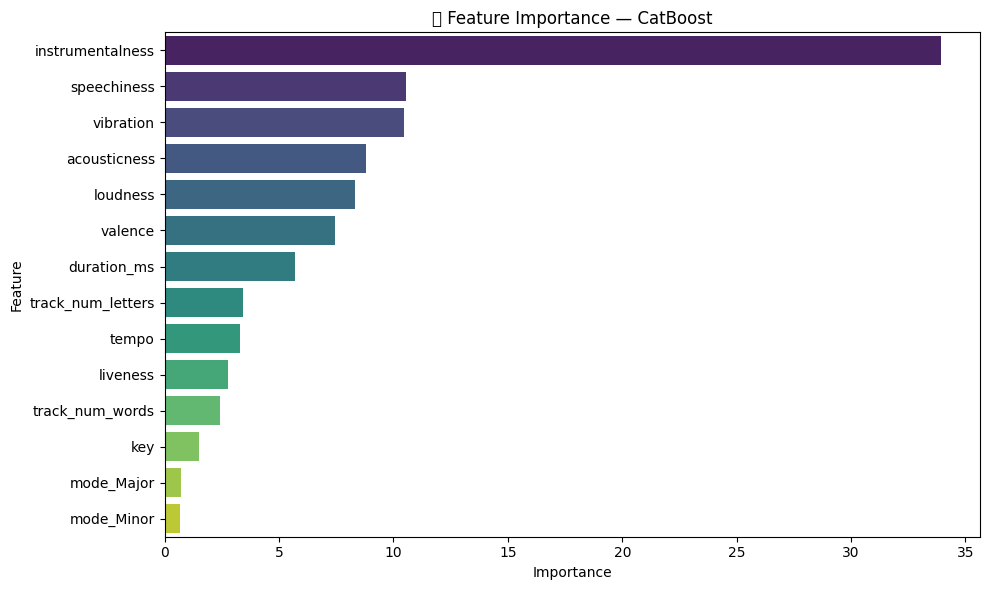

🔁 Обучение моделей: 100%|██████████| 7/7 [6:02:31<00:00, 3107.33s/it]


In [25]:

# CHOSEN MODELS USING OPTUNA (using a validation split from the training data)
from optuna.distributions import CategoricalDistribution, IntDistribution, FloatDistribution

models_and_params = {
    'LogisticRegression': {
        'model': LogisticRegression(max_iter=1000, random_state=RANDOM_STATE),
        'params': {
            'classifier__C': FloatDistribution(0.001, 100, log=True),
            'classifier__penalty': CategoricalDistribution(['l2']),
            'classifier__solver': CategoricalDistribution(['lbfgs'])
        }
    },
    'SVM': {
        'model': SVC(probability=True, random_state=RANDOM_STATE),
        'params': {
            'classifier__C': FloatDistribution(0.01, 100, log=True),
            'classifier__kernel': CategoricalDistribution(['linear', 'rbf'])
        }
    },
    'DecisionTree': {
        'model': DecisionTreeClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__max_depth': IntDistribution(3, 20),
            'classifier__min_samples_split': IntDistribution(2, 10)
        }
    },
    'RandomForest': {
        'model': RandomForestClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__n_estimators': IntDistribution(50, 200),
            'classifier__max_depth': IntDistribution(5, 30)
        }
    },
    'GradientBoosting': {
        'model': GradientBoostingClassifier(random_state=RANDOM_STATE),
        'params': {
            'classifier__n_estimators': IntDistribution(50, 200),
            'classifier__learning_rate': FloatDistribution(0.01, 0.3, log=True),
            'classifier__max_depth': IntDistribution(3, 10)
        }
    },
    'XGBoost': {
        'model': XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=RANDOM_STATE),
        'params': {
            'classifier__n_estimators': IntDistribution(50, 200),
            'classifier__max_depth': IntDistribution(3, 10)
        }
    },
    'CatBoost': {
        'model': CatBoostClassifier(verbose=0, random_state=RANDOM_STATE),
        'params': {
            'classifier__depth': IntDistribution(4, 10),
            'classifier__learning_rate': FloatDistribution(0.01, 0.3, log=True)
        }
    }
}

# RUNNING CHOSEN MODELS USING OPTUNA (using a validation split from the training data)

accuracies_optuna = {}
times_optuna = {}

for name, mp in tqdm(models_and_params.items(), desc="🔁 Обучение моделей"):
    print(f"\n🔍 Tuning {name} with Optuna...")

    try:
        start_time = time.time()

        # Split training data
        X_train_split, X_val_split, y_train_split, y_val_split = train_test_split(
            X_train, y_train, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y_train
        )

        # Label encode the target variable
        label_encoder = LabelEncoder()
        y_train_split_encoded = label_encoder.fit_transform(y_train_split)
        y_val_split_encoded = label_encoder.transform(y_val_split)


        pipeline = Pipeline([
            ('preprocessor', preprocessor),  # defined earlier
            ('classifier', mp['model'])
        ])

        # Define OptunaSearchCV
        optuna_search = OptunaSearchCV(
            pipeline,
            mp['params'],
            cv=3,
            scoring='accuracy',
            n_trials=30,
            n_jobs=-1,
            random_state=RANDOM_STATE,
            verbose=1
        )

        optuna_search.fit(X_train_split, y_train_split_encoded)
        y_pred_val = optuna_search.predict(X_val_split)

        elapsed_time = time.time() - start_time
        times_optuna[name] = elapsed_time

        acc = accuracy_score(y_val_split_encoded, y_pred_val)

        print(f"\n✅ Best parameters for {name}: {optuna_search.best_params_}")
        print(f"✅ Accuracy on validation set for {name}: {acc:.4f}")
        print(f"🕒 Training time for {name}: {elapsed_time:.2f} seconds")
        print(f"📋 Classification Report:\n{classification_report(y_val_split_encoded, y_pred_val)}")

        # Save accuracy
        accuracies_optuna[name] = acc

        # Save Optuna trial results
        cv_results_df = pd.DataFrame(optuna_search.cv_results_)
        csv_filename = f"{name}_optuna_results.csv"
        cv_results_df.to_csv(csv_filename, index=False)
        print(f"💾 Optuna results saved to: {csv_filename}")

        # 🔍 Показываем важность признаков
        best_pipeline = optuna_search.best_estimator_
        plot_feature_importance(best_pipeline, model_name=name)

    except Exception as e:
        print(f"\n❌ Ошибка при обучении модели {name}: {e}")
        traceback.print_exc()
        continue

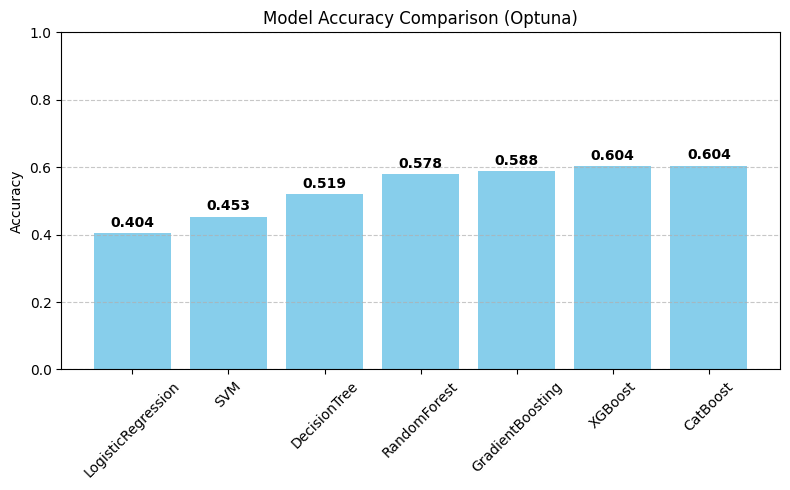

In [26]:
# PLOT ACCURACIES WITH LABELS FOR OPTUNA


plt.figure(figsize=(8, 5))
bars = plt.bar(accuracies_optuna.keys(), accuracies_optuna.values(), color='skyblue')

plt.ylabel('Accuracy')
plt.title('Model Accuracy Comparison (Optuna)')
plt.ylim(0, 1)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45)

for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height + 0.01,
        f"{height:.3f}",
        ha='center',
        va='bottom',
        fontsize=10,
        fontweight='bold'
    )

plt.tight_layout()
plt.show()

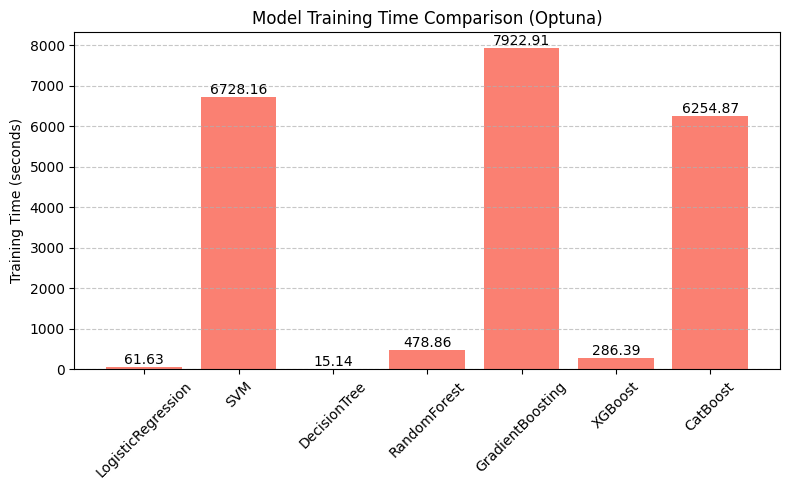

In [27]:
# PLOT RUNNING TIMES  FOR OPTUNA
plt.figure(figsize=(8, 5))
bars = plt.bar(times_optuna.keys(), times_optuna.values(), color='salmon')

plt.ylabel('Training Time (seconds)')
plt.title('Model Training Time Comparison (Optuna)')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45)

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2.0, yval, f"{yval:.2f}", va='bottom', ha='center') # Add labels

plt.tight_layout()
plt.show()

## Project summary

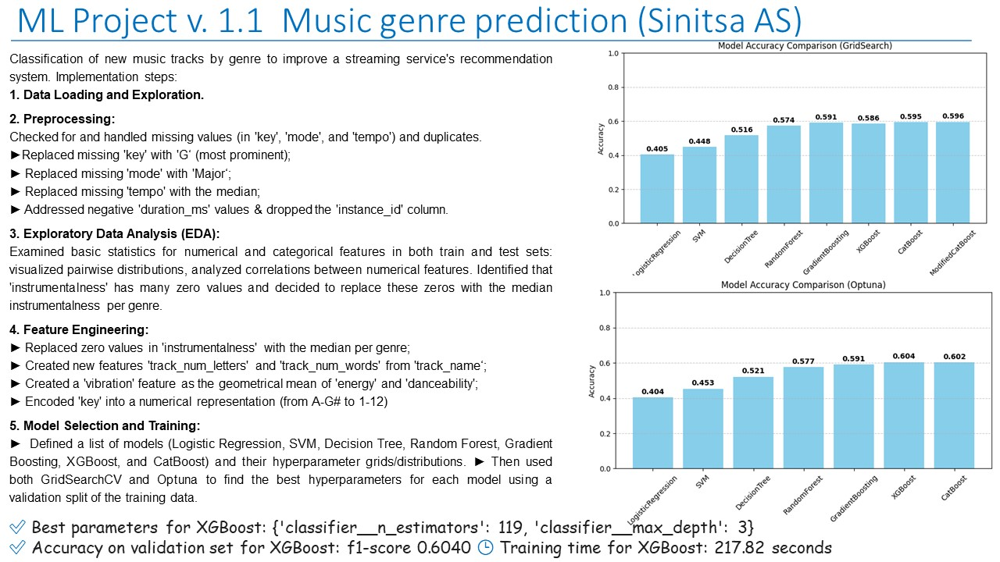